## Employee Churn Analysis Project

## Project Structure

1. Exploratory Data Analysis\
    Importing Modules\
    Loading Dataset\
    Data Insigts

2. Data Visualization\
    Employees Left\
    Determine Number of Projects\
    Determine Time Spent in Company\
    Subplots of Features

3. Data Pre-Processing\
    Scaling\
    Label Encoding

4. Cluster Analysis\
    Find the optimal number of clusters (k) using the elbow method for for K-means.\
    Determine the clusters by using K-Means then Evaluate predicted results.

5. Model Building\
    Split Data as Train and Test set\
    Built Gradient Boosting Classifier, Evaluate Model Performance and Predict Test Data\
    Built K Neighbors Classifier and Evaluate Model Performance and Predict Test Data\
    Built Random Forest Classifier and Evaluate Model Performance and Predict Test Data

6. Model Deployement\
    Save and Export the Model as .pkl\
    Save and Export Variables as .pkl

In [1]:
# if you need please install these libraries to import the following ones

# !pip install pyforest
# !pip install --user pycaret 
# !pip install pandas_profiling
# !pip install squarify
# !pip install termcolor
# !pip install catboost
# !pip install pyclustertend

In [2]:
# !pip install pyclustertend
# !pip install xgboost

In [3]:
# 1-Import Libraies

import pandas_profiling
import pyforest

import ipywidgets
from ipywidgets import interact

import numpy as np
import pandas as pd 

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.ticker as mticker
import squarify as sq

# Importing plotly and cufflinks in offline mode
import plotly.express as px
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

# !pip install termcolor
import colorama
from colorama import Fore, Style  # maakes strings colored
from termcolor import colored
from termcolor import cprint

#from wordcloud import WordCloud

import scipy.stats as stats
from scipy.cluster.hierarchy import linkage, dendrogram
import statsmodels.api as sm
import statsmodels.formula.api as smf
import missingno as msno 

import datetime as dt
from datetime import datetime

#from pyclustertend import hopkins

In [4]:
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.compose import make_column_transformer
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier, GradientBoostingRegressor 
from sklearn.ensemble import ExtraTreesRegressor, AdaBoostClassifier
from sklearn.feature_selection import SelectKBest, SelectPercentile, f_classif, f_regression, mutual_info_regression
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.metrics import plot_confusion_matrix, r2_score, mean_absolute_error, mean_squared_error, classification_report 
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import make_scorer, precision_score, precision_recall_curve, plot_precision_recall_curve 
from sklearn.metrics import plot_roc_curve, roc_auc_score, roc_curve, f1_score, accuracy_score, recall_score
from sklearn.metrics import silhouette_samples,silhouette_score
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold, KFold, cross_val_predict, train_test_split
from sklearn.model_selection import StratifiedKFold, GridSearchCV, cross_val_score, cross_validate
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsRegressor, KNeighborsClassifier
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import scale, StandardScaler, MinMaxScaler, RobustScaler
from sklearn.preprocessing import PolynomialFeatures, OneHotEncoder, PowerTransformer, LabelEncoder 
from sklearn.svm import SVR, SVC
from sklearn.tree import plot_tree, DecisionTreeClassifier
from yellowbrick.classifier import ClassificationReport

from xgboost import XGBRegressor, XGBClassifier, plot_importance

In [5]:
# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

# Figure&Display options
plt.rcParams["figure.figsize"] = (10,6)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# To suppress Pandas Future warning
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [6]:
# https://www.kaggle.com/azizozmen/employee-churn-attrition-predict-eda-multi-algos

In [7]:
## Some Useful Functions

def missing_values(df):
    missing_number = df.isnull().sum().sort_values(ascending = False)
    missing_percent = (df.isnull().sum() / df.isnull().count()).sort_values(ascending = False)
    missing_values = pd.concat([missing_number, missing_percent], axis = 1, keys = ['Missing_Number', 'Missing_Percent'])
    return missing_values[missing_values['Missing_Number'] > 0]

def first_looking(df):
    print(colored("Shape:", attrs=['bold']), df.shape,'\n', 
          colored('*'*100, 'red', attrs = ['bold']),
          colored("\nInfo:\n", attrs = ['bold']), sep = '')
    print(df.info(), '\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Number of Uniques:\n", attrs = ['bold']), df.nunique(),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Missing Values:\n", attrs=['bold']), missing_values(df),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("All Columns:", attrs = ['bold']), list(df.columns),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')

    df.columns = df.columns.str.lower().str.replace('&', '_').str.replace(' ', '_')
    print(colored("Columns after rename:", attrs = ['bold']), list(df.columns),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')  
    print(colored("Columns after rename:", attrs = ['bold']), list(df.columns),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Descriptive Statistics \n", attrs = ['bold']), df.describe().round(2),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '') # Gives a statstical breakdown of the data.
    print(colored("Descriptive Statistics (Categorical Columns) \n", attrs = ['bold']), df.describe(include = object).T,'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '') # Gives a statstical breakdown of the data.
    
def multicolinearity_control(df):
    feature = []
    collinear = []
    for col in df.corr().columns:
        for i in df.corr().index:
            if (abs(df.corr()[col][i]) > .9 and abs(df.corr()[col][i]) < 1):
                    feature.append(col)
                    collinear.append(i)
                    print(colored(f"Multicolinearity alert in between:{col} - {i}", 
                                  "red", attrs = ['bold']), df.shape,'\n',
                                  colored('*'*100, 'red', attrs = ['bold']), sep = '')

def duplicate_values(df):
    print(colored("Duplicate check...", attrs = ['bold']), sep = '')
    print("There are", df.duplicated(subset = None, keep = 'first').sum(), "duplicated observations in the dataset.")
    duplicate_values = df.duplicated(subset = None, keep = 'first').sum()
    if duplicate_values > 0:
        df.drop_duplicates(keep = 'first', inplace = True)
        print(duplicate_values, colored(" Duplicates were dropped!"),'\n',
              colored('*'*100, 'red', attrs = ['bold']), sep = '')
        
def drop_null(df, limit):
    print('Shape:', df.shape)
    for i in df.isnull().sum().index:
        if (df.isnull().sum()[i] / df.shape[0]*100) > limit:
            print(df.isnull().sum()[i], 'percent of', i ,'null and were dropped')
            df.drop(i, axis = 1, inplace = True)
            print('new shape:', df.shape)       
    print('New shape after missing value control:', df.shape)
    
# To view summary information about the columns

def first_look(col):
    print("column name    : ", col)
    print("--------------------------------")
    print("Per_of_Nulls   : ", "%", round(df[col].isnull().sum() / df.shape[0]*100, 2))
    print("Num_of_Nulls   : ", df[col].isnull().sum())
    print("Num_of_Uniques : ", df[col].nunique())
    print("Duplicates     : ", df.duplicated(subset = None, keep = 'first').sum())
    print(df[col].value_counts(dropna = False))
    
def fill_most(df, group_col, col_name):
    '''Fills the missing values with the most existing value (mode) in the relevant column according to single-stage grouping'''
    for group in list(df[group_col].unique()):
        cond = df[group_col] == group
        mode = list(df[cond][col_name].mode())
        if mode != []:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[cond][col_name].mode()[0])
        else:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[col_name].mode()[0])
    print("Number of NaN : ",df[col_name].isnull().sum())
    print("------------------")
    print(df[col_name].value_counts(dropna = False))
    
# show values in bar graphic

def show_values_on_bars(axs):
    def _show_on_single_plot(ax):        
        for p in ax.patches:
            _x = p.get_x() + p.get_width() / 2
            _y = p.get_y() + p.get_height()
            value = '{:.2f}'.format(p.get_height())
            ax.text(_x, _y, value, ha="center") 
    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

In [8]:
df0 = pd.read_csv('HR_Dataset.csv')
df = df0.copy()
df.head() 

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
0,0.380,0.530,2,157,3,0,1,0,sales,low
1,0.800,0.860,5,262,6,0,1,0,sales,medium
2,0.110,0.880,7,272,4,0,1,0,sales,medium
3,0.720,0.870,5,223,5,0,1,0,sales,low
4,0.370,0.520,2,159,3,0,1,0,sales,low


In [9]:
df.tail() 

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
14994,0.400,0.570,2,151,3,0,1,0,support,low
14995,0.370,0.480,2,160,3,0,1,0,support,low
14996,0.370,0.530,2,143,3,0,1,0,support,low
14997,0.110,0.960,6,280,4,0,1,0,support,low
14998,0.370,0.520,2,158,3,0,1,0,support,low


In [10]:
df.sample(5)

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
11784,0.720,0.880,3,189,3,1,0,0,management,high
10723,0.600,0.800,4,253,2,0,0,0,technical,low
1561,0.110,0.880,6,290,4,0,1,0,hr,low
3407,0.540,0.430,3,192,2,0,0,0,support,low
7212,0.660,0.960,4,160,2,0,0,0,technical,medium


## Data Cleaning and EDA

Pandas profiling is an open source Python module with which we can quickly do an exploratory data analysis with just a few lines of code. Similarly, for EDA, profile_report() is One-Line Magical Code creating reports in the interactive HTML format which is quite easy to understand and analyze the data. In short, at the first hand, what pandas profiling does is to save us all the work of visualizing and understanding the distribution of each variable.

For a better understanding and more information, please refer to Source 1 & Source 2

In [11]:
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
first_looking(df)
duplicate_values(df)
print(colored("Shape:", attrs = ['bold']), df.shape,'\n', colored('*'*100, 'red', attrs = ['bold']))

Shape:(14999, 10)
****************************************************************************************************
Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14999 entries, 0 to 14998
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   satisfaction_level     14999 non-null  float64
 1   last_evaluation        14999 non-null  float64
 2   number_project         14999 non-null  int64  
 3   average_montly_hours   14999 non-null  int64  
 4   time_spend_company     14999 non-null  int64  
 5   Work_accident          14999 non-null  int64  
 6   left                   14999 non-null  int64  
 7   promotion_last_5years  14999 non-null  int64  
 8   Departments            14999 non-null  object 
 9   salary                 14999 non-null  object 
dtypes: float64(2), int64(6), object(2)
memory usage: 1.1+ MB
None
**************************************************************************

According to the basic examinations on the dataset;

- There has been a classification problem.
- We are going to make classification on the target variable "left".
- So a model will be built to get the best classification on the "left" column.
- Moreover, being balanced of "left" column or not will be take into consideration meticolously.
- The dataset has 10 columns and 11991 observations after dropping of duplicated observations.
- 8 columns contain numerical values and 2 columns contain categorical values.
- There seems to be no missing value.

In [13]:
df.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident', 'left',
       'promotion_last_5years', 'departments_', 'salary'],
      dtype='object')

In [14]:
df.rename({'departments_': 'department'}, axis=1, inplace=True)
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary
0,0.380,0.530,2,157,3,0,1,0,sales,low
1,0.800,0.860,5,262,6,0,1,0,sales,medium
2,0.110,0.880,7,272,4,0,1,0,sales,medium
3,0.720,0.870,5,223,5,0,1,0,sales,low
4,0.370,0.520,2,159,3,0,1,0,sales,low


In [15]:
# Alternative code
# last_column = df.pop('left')
# df.insert(9, 'left', last_column)
# df.head(1)

df = df[['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'department', 'salary', 'left']]
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left
0,0.380,0.530,2,157,3,0,0,sales,low,1
1,0.800,0.860,5,262,6,0,0,sales,medium,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1
3,0.720,0.870,5,223,5,0,0,sales,low,1
4,0.370,0.520,2,159,3,0,0,sales,low,1


## 4.2 - The Examination of Features


In the given dataset, we have two types of employee one who stayed and another who left the company. So, we can divide data into two groups and compare their characteristics. Here, we can find the average of both the groups using groupby() and mean() function.

- Before jumping into modelling, let's try to get some information by examining the columns in the dataset one by one.

'left' Column-Target Column

In [16]:
cprint("Have a First Look to 'left' Column",'green')
first_look('left')

Have a First Look to 'left' Column
column name    :  left
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  2
Duplicates     :  0
0    10000
1     1991
Name: left, dtype: int64


In [17]:
df['left'].value_counts().iplot(kind="bar", title = '"left" Column Distribution')

In [18]:
fig = px.pie(df, values = df['left'].value_counts(), 
             names = (df['left'].value_counts()).index, 
             title = '"left" Column Distribution')
fig.show()

In [19]:
y = df['left']
print(f'Percentage of left-1: % {round(y.value_counts(normalize=True)[1]*100,2)} --> \
({y.value_counts()[1]} observations for left-1)\nPercentage of left-0: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} observations for left-0)')

Percentage of left-1: % 16.6 --> (1991 observations for left-1)
Percentage of left-0: % 83.4 --> (10000 observations for left-0)


- The target column, 'left', has binary type values.
- There has been an imbalanced data for the analysis.
- Almost 17% of the employees prefered NOT to continue with the company and left.
- 1991 employees left.
- Almost 83% of the employees prefered to continue with the company and stayed.
- 10000 employees stayed.

In [20]:
df.groupby('left').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years
left,,,,,,,
0,0.667,0.716,3.787,198.943,3.262,0.174,0.019
1,0.440,0.722,3.883,208.162,3.881,0.053,0.004


In [21]:
cprint('Dataset describe results according to the "left==1" condition','green')
df[df['left'] == 1].describe().T.style.background_gradient(subset = ['mean','min','50%', 'max'], cmap = 'RdPu')

Dataset describe results according to the "left==1" condition


,count,mean,std,min,25%,50%,75%,max
satisfaction_level,1991.000000,0.440271,0.265207,0.090000,0.110000,0.410000,0.730000,0.920000
last_evaluation,1991.000000,0.721783,0.197436,0.450000,0.520000,0.790000,0.910000,1.000000
number_project,1991.000000,3.883476,1.817139,2.000000,2.000000,4.000000,6.000000,7.000000
average_montly_hours,1991.000000,208.162230,61.295145,126.000000,146.000000,226.000000,262.500000,310.000000
time_spend_company,1991.000000,3.881467,0.974041,2.000000,3.000000,4.000000,5.000000,6.000000
work_accident,1991.000000,0.052737,0.223565,0.000000,0.000000,0.000000,0.000000,1.000000
promotion_last_5years,1991.000000,0.004018,0.063277,0.000000,0.000000,0.000000,0.000000,1.000000
left,1991.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [22]:
cprint('Dataset describe results according to the "left==0" condition','green')
df[df['left'] == 0].describe().T.style.background_gradient(subset = ['mean','min','50%', 'max'], cmap = 'RdPu')

Dataset describe results according to the "left==0" condition


,count,mean,std,min,25%,50%,75%,max
satisfaction_level,10000.000000,0.667365,0.217082,0.120000,0.540000,0.690000,0.840000,1.000000
last_evaluation,10000.000000,0.715667,0.161919,0.360000,0.580000,0.710000,0.850000,1.000000
number_project,10000.000000,3.786800,0.981755,2.000000,3.000000,4.000000,4.000000,6.000000
average_montly_hours,10000.000000,198.942700,45.665507,96.000000,162.000000,198.000000,238.000000,287.000000
time_spend_company,10000.000000,3.262000,1.367239,2.000000,2.000000,3.000000,4.000000,10.000000
work_accident,10000.000000,0.174500,0.379558,0.000000,0.000000,0.000000,0.000000,1.000000
promotion_last_5years,10000.000000,0.019500,0.138281,0.000000,0.000000,0.000000,0.000000,1.000000
left,10000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


'satisfaction_level' Column

In [23]:
cprint("Have a First Look to 'left' Column",'green')
first_look('satisfaction_level')

Have a First Look to 'left' Column
column name    :  satisfaction_level
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  92
Duplicates     :  0
0.740    214
0.100    203
0.730    201
0.500    200
0.720    199
0.840    199
0.830    196
0.770    194
0.780    194
0.660    192
0.890    191
0.110    188
0.750    188
0.760    188
0.910    187
0.800    186
0.590    185
0.630    184
0.820    180
0.570    179
0.960    179
0.690    178
0.850    177
0.490    177
0.790    177
0.810    176
0.610    176
0.870    176
0.700    176
0.900    172
0.520    172
0.650    171
0.860    170
0.600    167
0.560    166
0.540    166
0.980    165
0.640    164
0.920    163
0.580    162
0.620    162
0.880    160
0.510    160
0.550    159
0.670    158
0.990    157
0.950    153
0.710    152
0.970    150
0.530    150
0.930    148
0.680    145
0.940    143
0.430    141
0.440    138
0.370    130
0.400    126
0.450    121
0.480    120
0.380    116
0.390    111
0.090    110
0.42

In [24]:
df['satisfaction_level'].value_counts().iplot(kind="bar", title = '"satisfaction_level" Column Distribution')

In [25]:
px.histogram(df, x = df['satisfaction_level'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'satisfaction_level and left')

In [26]:
pd.crosstab(df['satisfaction_level'], df['left']).iplot(kind='bar', title = 'satisfaction_level and left')

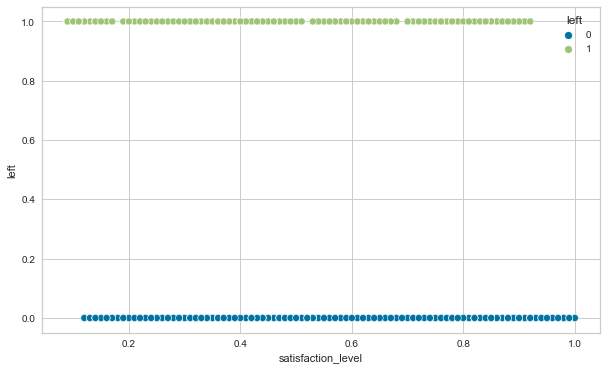

In [27]:
sns.scatterplot(data=df, x="satisfaction_level", y="left", hue="left");

In [28]:
df.corr(method='pearson')[7:]

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left
left,-0.351,0.014,0.031,0.070,0.173,-0.125,-0.045,1.000


- Although it is expected that there should be a linear relationship between 'satisfaction_level' and 'left', it does not seem clearly on the graph due to the type of "left" feature.
- Those with a 'satisfaction_level' value of around 0.1 are more likely to be 'left'.
- There is a significant increase in the number of those labeled 'left' whose 'satisfaction_level' value is between 0.55. In fact, the number of those who left their companies exceeds that of the ones who not.
- When the 'satisfaction_level' value is around between 0.7 and 0.9, there is an increase in the number of those who left.
- Except for these intervals, no matter how low the satisfaction_level was, the employees continued their work.

## 'last_evaluation' Column

In [29]:
cprint("Have a First Look to 'last_evaluation' Column",'green')
first_look('last_evaluation')

Have a First Look to 'last_evaluation' Column
column name    :  last_evaluation
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  65
Duplicates     :  0
0.550    281
0.500    269
0.510    264
0.570    258
0.540    252
0.560    248
0.530    247
0.850    244
0.900    244
0.490    242
0.870    241
0.890    235
0.520    233
0.740    227
0.910    224
0.590    221
0.860    219
0.840    218
0.970    218
0.770    212
0.480    212
0.830    211
0.950    211
0.810    210
0.750    209
0.930    209
0.960    208
0.980    208
0.920    207
0.670    205
0.630    204
0.580    203
0.800    201
1.000    200
0.610    200
0.940    199
0.640    198
0.620    197
0.990    197
0.790    195
0.820    195
0.680    193
0.760    192
0.660    191
0.730    189
0.880    187
0.600    186
0.700    184
0.720    182
0.780    181
0.650    176
0.690    176
0.710    171
0.460    131
0.470    121
0.450     78
0.410     52
0.400     49
0.370     46
0.390     45
0.420     45
0.430    

In [30]:
df['last_evaluation'].value_counts().iplot(kind="bar", title = '"last_evaluation" Column Distribution')

In [31]:
px.histogram(df, x = df['last_evaluation'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'last_evaluation and left')

In [32]:
pd.crosstab(df['last_evaluation'], df['left']).iplot(kind='bar', title = 'last_evaluation and left')

- There is a local increase between 0.45-0.6 and 0.8-1 in the 'last_evaluation' values, as in 'satisfaction_level' values. There is an increase in the number of people who quit their jobs in these intervals.

### 'number_project' Column

In [33]:
cprint("Have a First Look to 'number_project' Column",'green')
first_look('number_project')

Have a First Look to 'number_project' Column
column name    :  number_project
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  6
Duplicates     :  0
4    3685
3    3520
5    2233
2    1582
6     826
7     145
Name: number_project, dtype: int64


In [34]:
df['number_project'].value_counts().iplot(kind="bar", title = '"number_project" Column Distribution')

In [35]:
fig = px.pie(df, values = df['number_project'].value_counts(), 
             names = (df['number_project'].value_counts()).index, 
             title = '"number_project" Column Distribution')
fig.show()

In [36]:
px.histogram(df, x = df['number_project'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'number_project and left')

In [37]:
pd.crosstab(df['number_project'], df['left']).iplot(kind='bar', title = 'number_project and left')

It's clear that the employees who made 2, 6 and 7 projects are more inclined to leave their works. It's normal to expect employees who made more projects but not getting more salary or feeling more satisfaction to leave their works;however, those who left even though making less projects should be scrutinized more meticulously.

### 'average_montly_hours' Column

In [38]:
cprint("Have a First Look to 'average_montly_hours' Column",'green')
first_look('average_montly_hours')

Have a First Look to 'average_montly_hours' Column
column name    :  average_montly_hours
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  215
Duplicates     :  0
156    112
149    112
160    111
151    107
135    104
260    102
257    100
145     98
157     96
224     94
152     94
143     94
140     93
155     93
139     92
137     92
141     91
243     91
245     91
238     91
158     90
154     90
148     90
159     89
264     87
150     87
142     87
258     86
134     85
271     85
162     85
255     85
147     85
153     85
266     84
146     84
269     83
254     83
246     82
253     82
167     81
263     81
168     81
185     81
136     81
247     81
173     81
237     79
250     79
226     79
192     79
251     78
144     78
233     78
261     78
201     77
229     77
270     77
232     77
248     76
169     76
242     75
249     75
274     75
206     74
171     74
225     74
272     74
239     74
259     73
189     73
183     73

In [39]:
df['average_montly_hours'].value_counts().iplot(kind="bar", title = '"average_montly_hours" Column Distribution')

In [40]:
px.histogram(df, x = df['average_montly_hours'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'average_montly_hours and left')

In [41]:
pd.crosstab(df['average_montly_hours'], df['left']).iplot(kind='bar', title = 'average_montly_hours and left')

- Looking at the 'average_montly_hours' values, there is a local increase in turnover in the 125-160 month working hours range and 210-290 monthly working hours.
- Those who work more than 290 hours per month are more likely to quit their jobs than those who do not.

How does workload affect employee churn?

(0.0, 100.0)

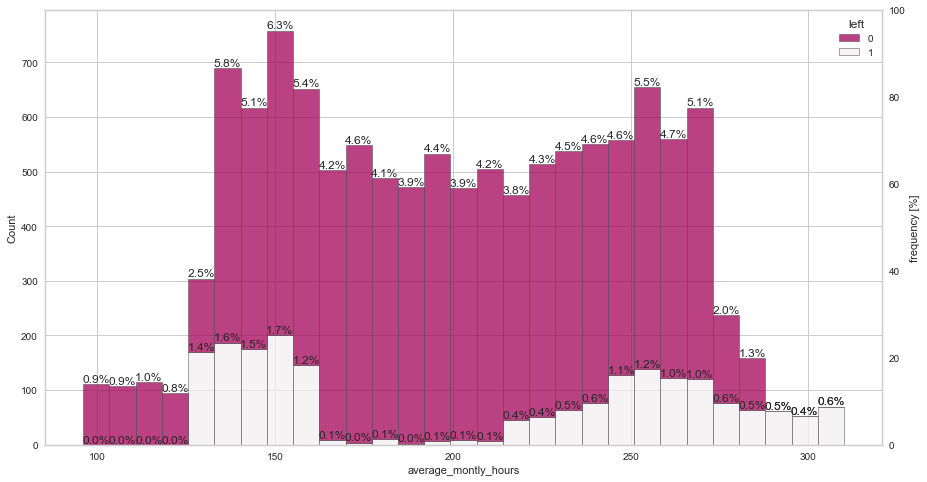

In [42]:
plt.figure(figsize=(15, 8))
fig = sns.histplot(
    df,
    x="average_montly_hours", hue="left",
    multiple="stack",
    palette="light:m_r",
    edgecolor=".3",
    linewidth=.5
)
fig2 = fig.twinx()

fig.yaxis.set_label_position('left')
fig2.yaxis.set_label_position('right')

fig2.set_ylabel('frequency [%]')

for p in fig.patches:
    x=p.get_bbox().get_points()[:,0]
    y=p.get_bbox().get_points()[1,1]
    fig.annotate('{:.1f}%'.format(100.*y/len(df)), (x.mean(), y), 
            ha='center', va='bottom') # set the alignment of the text
fig2.grid(None)
fig2.set_ylim(0,100)

It can be stated that tendency to left company regarding work-load has five phases;

- Below 125 hours/month there is no churn
- 125-160 hours/month churn rate is highest
- 160-220 hours/month churn rate very low (neglectable)
- 220-288 hours/month churn rate high (has a bell shape)
- Over 288 hours/month churn rate %100!!!
### 'time_spend_company' Column

In [43]:
cprint("Have a First Look to 'time_spend_company' Column",'green')
first_look('number_project')

Have a First Look to 'time_spend_company' Column
column name    :  number_project
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  6
Duplicates     :  0
4    3685
3    3520
5    2233
2    1582
6     826
7     145
Name: number_project, dtype: int64


In [44]:
df['time_spend_company'].value_counts().iplot(kind="bar", title = '"time_spend_company" Column Distribution')

In [45]:
fig = px.pie(df, values = df['time_spend_company'].value_counts(), 
             names = (df['time_spend_company'].value_counts()).index, 
             title = '"time_spend_company" Column Distribution')
fig.show()

In [46]:
px.histogram(df, x = df['time_spend_company'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'time_spend_company and left')

In [47]:
pd.crosstab(df['time_spend_company'], df['left']).iplot(kind='bar', title = 'time_spend_company and left')

- Looking at the 'time_spent_company' values, there is an increase in turnover in the 3rd working year, but this increase gradually decreases until the 6th working year.

### 'work_accident' Column

In [48]:
cprint("Have a First Look to 'work_accident' Column",'green')
first_look('work_accident')

Have a First Look to 'work_accident' Column
column name    :  work_accident
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  2
Duplicates     :  0
0    10141
1     1850
Name: work_accident, dtype: int64


In [49]:
df['work_accident'].value_counts().iplot(kind="bar", title = '"work_accident" Column Distribution')

In [50]:
fig = px.pie(df, values = df['work_accident'].value_counts(), 
             names = (df['work_accident'].value_counts()).index, 
             title = '"work_accident" Column Distribution')
fig.show()

In [51]:
px.histogram(df, x = df['work_accident'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'work_accident and left')

In [52]:
pd.crosstab(df['work_accident'], df['left']).iplot(kind='bar', title = 'work_accident and left')

- 'work_accident' column has binary type values. - While the employees who don't get involved in accident are more likely to leave with a value of 22.84%, those who get involved in accident are less likely to leave with a value of 6.02%.
- Altough it does not appear to be a determining factor and needs to be examined carefully by looking at the conditions at workplace, companies' policies and etc.; in fact, it could be said that the left rate of those who have got involved in a work accident is proportionally lower than those who did NOT.

### 'promotion_last_5years' Column

In [53]:
cprint("Have a First Look to 'promotion_last_5years' Column",'green')
first_look('promotion_last_5years')

Have a First Look to 'promotion_last_5years' Column
column name    :  promotion_last_5years
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  2
Duplicates     :  0
0    11788
1      203
Name: promotion_last_5years, dtype: int64


In [54]:
df['promotion_last_5years'].value_counts().iplot(kind="bar", title = '"promotion_last_5years" Column Distribution')

In [55]:
fig = px.pie(df, values = df['promotion_last_5years'].value_counts(), 
             names = (df['promotion_last_5years'].value_counts()).index, 
             title = '"promotion_last_5years" Column Distribution')
fig.show()

In [56]:
px.histogram(df, x = df['promotion_last_5years'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'promotion_last_5years and left')

In [57]:
pd.crosstab(df['promotion_last_5years'], df['left']).iplot(kind='bar', title = 'promotion_last_5years and left')

- 'promotion_last_5years' column has binary type values.
- Receiving a promotion in the last 5 working years is not determinant in terms of leaving or continuing to work.
- However, the percentage of those who receive promotions, even if it is small, are higher than those who do not.

### 'department' Column

In [58]:
cprint("Have a First Look to 'department' Column",'green')
first_look('department')

Have a First Look to 'department' Column
column name    :  department
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  10
Duplicates     :  0
sales          3239
technical      2244
support        1821
IT              976
RandD           694
product_mng     686
marketing       673
accounting      621
hr              601
management      436
Name: department, dtype: int64


In [59]:
df['department'].value_counts().iplot(kind="bar", title = '"department" Column Distribution')

In [60]:
fig = px.pie(df, values = df['department'].value_counts(), 
             names = (df['department'].value_counts()).index, 
             title = '"department" Column Distribution')
fig.show()

In [61]:
px.histogram(df, x = df['department'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'department and left')

In [62]:
pd.crosstab(df['department'], df['left']).iplot(kind='bar', title = 'department and left')

- It is not observed that the departments which require the employees to work alone have an effect on the decision of "left".
- It is seen that the left percentages of the departments are quite similar.

### 'salary' Column

In [63]:
cprint("Have a First Look to 'salary' Column",'green')
first_look('salary')

Have a First Look to 'salary' Column
column name    :  salary
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  3
Duplicates     :  0
low       5740
medium    5261
high       990
Name: salary, dtype: int64


In [64]:
df['salary'].value_counts().iplot(kind="bar", title = '"salary" Column Distribution')

In [65]:
fig = px.pie(df, values = df['salary'].value_counts(), 
             names = (df['salary'].value_counts()).index, 
             title = '"salary" Column Distribution')
fig.show()

In [66]:
px.histogram(df, x = df['salary'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'salary and left')

In [67]:
pd.crosstab(df['salary'], df['left']).iplot(kind='bar', title = 'salary and left')

- Naturally as salary rises, churn rate decreeses.
- Even if it is small, there is an increase in the form of high-medium-low according to the salary status.

Let's go on with the examination of numerical and categorical columns.

In [68]:
numerical= df.drop(['left'], axis=1).select_dtypes('number').columns

categorical = df.select_dtypes('object').columns

print(colored("Numerical Columns:", attrs=['bold']), list(df[numerical].columns),'\n',
              colored('-'*124, 'red', attrs=['bold']), sep='')
print(colored("Categorical Columns:", attrs=['bold']), list(df[categorical].columns),'\n',
              colored('-'*124, 'red', attrs=['bold']), sep='')

Numerical Columns:['satisfaction_level', 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 'work_accident', 'promotion_last_5years']
----------------------------------------------------------------------------------------------------------------------------
Categorical Columns:['department', 'salary']
----------------------------------------------------------------------------------------------------------------------------


### categorical variables

In [69]:
df[categorical].head().T

,0,1,2,3,4
department,sales,sales,sales,sales,sales
salary,low,medium,medium,low,low


In [70]:
df[categorical].describe().T.style.background_gradient(subset=['unique','freq','count'], cmap='RdPu')

,count,unique,top,freq
department,11991,10,sales,3239
salary,11991,3,low,5740


In [71]:
df[categorical].nunique()

department    10
salary         3
dtype: int64

It looks like there has NOT been a high cardinality issue.

In [72]:
for i, col in enumerate(df[categorical].columns):
    fig = px.histogram(df[col], color=df["left"], width=800, height=800, title=col, pattern_shape=df["salary"], pattern_shape_sequence=["x", ".", "+"])
    fig.show()

In [73]:
# sns.swarmplot(y="satisfaction_level", x="salary", hue="left", data=df, palette="husl");

In [74]:
# sns.swarmplot(y="average_montly_hours", x="department", hue="left", data=df, palette="husl");

In [75]:
# sns.swarmplot(y="number_project", x="department", hue="left", data=df, palette="husl");

In [76]:
# sns.swarmplot(y="time_spend_company", x="department", hue="left", data=df, palette="husl");

Now, let's examine crosstab outputs for each variable.

In [77]:
for i, col in enumerate(df[categorical].columns):
    xtab = pd.crosstab(df[col], df["left"], normalize=True)
    print(colored('-'*40, 'red', attrs=['bold']), sep='')
    print(xtab*100)

----------------------------------------
left             0     1
department              
IT           6.822 1.318
RandD        5.079 0.709
accounting   4.270 0.909
hr           4.070 0.942
management   3.202 0.434
marketing    4.679 0.934
product_mng  4.804 0.917
sales       22.425 4.587
support     12.584 2.602
technical   15.462 3.252
----------------------------------------
left        0     1
salary             
high    7.856 0.400
low    38.079 9.791
medium 37.461 6.413


### numerical variables

In [78]:
numerical= df.drop(['left'], axis = 1).select_dtypes('number').columns

categorical = df.select_dtypes('object').columns

print('---------------------')
print(f'Numerical Columns:  {df[numerical].columns}')
print(f'Categorical Columns: {df[categorical].columns}')
print('---------------------')

---------------------
Numerical Columns:  Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years'],
      dtype='object')
Categorical Columns: Index(['department', 'salary'], dtype='object')
---------------------


In [79]:
df[numerical].describe().T.style.background_gradient(subset = ['mean','std','50%','count'], cmap = 'RdPu')

,count,mean,std,min,25%,50%,75%,max
satisfaction_level,11991.000000,0.629658,0.241070,0.090000,0.480000,0.660000,0.820000,1.000000
last_evaluation,11991.000000,0.716683,0.168343,0.360000,0.570000,0.720000,0.860000,1.000000
number_project,11991.000000,3.802852,1.163238,2.000000,3.000000,4.000000,5.000000,7.000000
average_montly_hours,11991.000000,200.473522,48.727813,96.000000,157.000000,200.000000,243.000000,310.000000
time_spend_company,11991.000000,3.364857,1.330240,2.000000,3.000000,3.000000,4.000000,10.000000
work_accident,11991.000000,0.154282,0.361234,0.000000,0.000000,0.000000,0.000000,1.000000
promotion_last_5years,11991.000000,0.016929,0.129012,0.000000,0.000000,0.000000,0.000000,1.000000


In [80]:
df[numerical].iplot(kind = 'histogram', subplots = True, bins = 50)

In [81]:
for i in numerical:
    df[i].iplot(kind = 'box', title = i, boxpoints = 'all')

In [82]:
# sns.pairplot(df, hue = "left", corner = True);

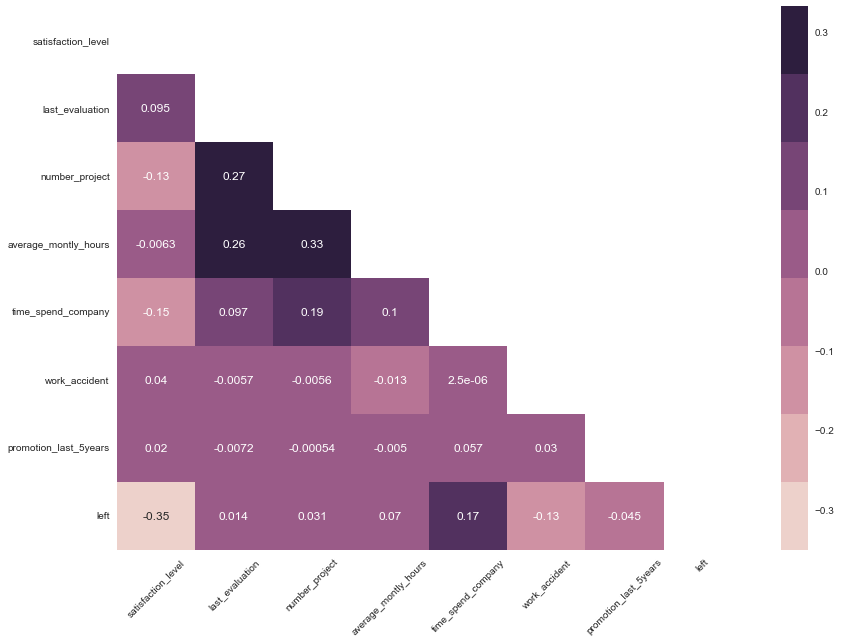

In [83]:
plt.figure(figsize=(14, 10))

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(df.corr())

# using the upper triangle matrix as mask 
sns.heatmap(df.corr(), annot=True, cmap = sns.cubehelix_palette(8), mask=matrix)

plt.xticks(rotation=45);

In [84]:
df.corr()['left'].sort_values().drop('left').iplot(kind = 'barh', colors='purple');

In [85]:
df_temp = df.corr()

count = 'Done'
feature =[]
collinear= []
for col in df_temp.columns:
    for i in df_temp.index:
        if (df_temp[col][i] > .9 and df_temp[col][i] < 1) or (df_temp[col][i] < -.9 and df_temp[col][i] > -1) :
                feature.append(col)
                collinear.append(i)
                print(Fore.RED + f'\033[1mmulticolinearity alert in between\033[0m {col} - {i}')
        else:
            print(f'For {col} and {i}, there is NO multicollinearity problem') 

print('\033[1mThe number of strong corelated features:\033[0m', count) 

For satisfaction_level and satisfaction_level, there is NO multicollinearity problem
For satisfaction_level and last_evaluation, there is NO multicollinearity problem
For satisfaction_level and number_project, there is NO multicollinearity problem
For satisfaction_level and average_montly_hours, there is NO multicollinearity problem
For satisfaction_level and time_spend_company, there is NO multicollinearity problem
For satisfaction_level and work_accident, there is NO multicollinearity problem
For satisfaction_level and promotion_last_5years, there is NO multicollinearity problem
For satisfaction_level and left, there is NO multicollinearity problem
For last_evaluation and satisfaction_level, there is NO multicollinearity problem
For last_evaluation and last_evaluation, there is NO multicollinearity problem
For last_evaluation and number_project, there is NO multicollinearity problem
For last_evaluation and average_montly_hours, there is NO multicollinearity problem
For last_evaluatio

In [86]:
df.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'department', 'salary', 'left'],
      dtype='object')

Based on the examinations made above;
- There is no multicollinearity problem among the features.
- We have weak level correlation between the numerical features and the target column.
- Also there is weak level correlation between the columns.
- Target variable demonstrates a slight negative correlation with the variables of "satisfaction_level", "promotion_last_5years" and 'work_accident',
- Target variable of "left" demonstrates weak correlation with the variables of 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 'department' and 'salary'.
- "satisfaction_level", even if it's quite small, has more influence on the decision to leave work with a negative value than other features.
- The increase in spending time at workplace positively affects the decision to leave with the company.

## 5) DATA VISUALIZATION


- Employees Left
- Determine Number of Projects
- Determine Time Spent in Company

### - Subplots of Features
You can search for answers to the following questions using data visualization methods. Based on these responses, you can develop comments about the factors that cause churn.

- How does the promotion status affect employee churn?
- How does years of experience affect employee churn?
- How does workload affect employee churn?
- How does the salary level affect employee churn?

### A General Look at the Data
Let's check how many employees were left?
Here, you can plot a bar graph using Matplotlib. The bar graph is suitable for showing discrete variable counts.

In [87]:
cprint('"left" Column Distribution','green')
df.left.value_counts()

"left" Column Distribution


0    10000
1     1991
Name: left, dtype: int64

In [88]:
# with plotly

df['left'].value_counts().iplot(kind="bar", title = '"left" Column Distribution')

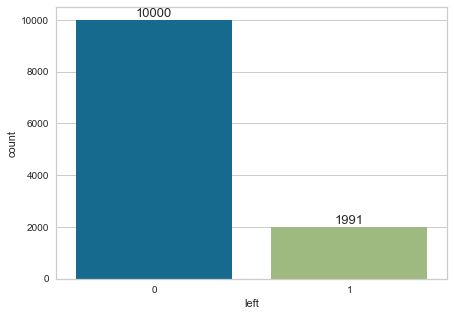

In [89]:
# with seaborn

plt.figure(figsize = (7,5))
sns.countplot(data = df, x = 'left');
for index,value in enumerate(df.left.value_counts()):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13);

"left" Column Distribution


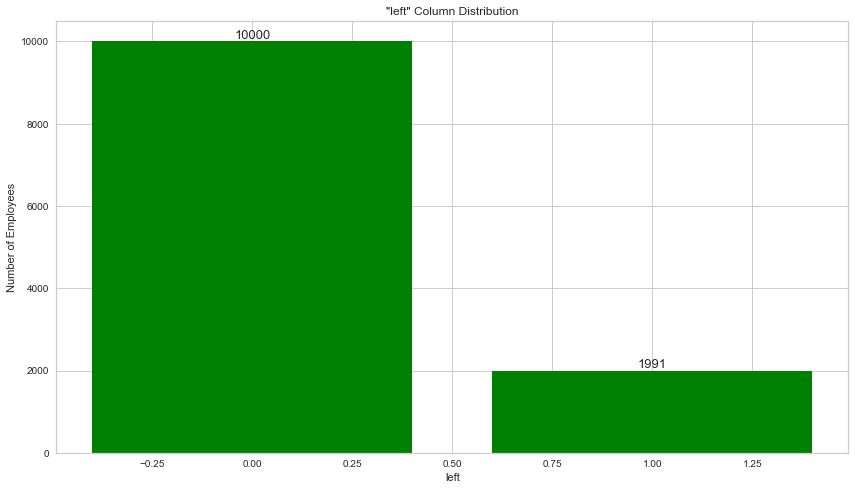

In [90]:
cprint('"left" Column Distribution','green')
fig = plt.figure(figsize = (11, 6))
ax = fig.add_axes([0, 0, 1, 1])
ax.bar(df.left.value_counts().index, df.left.value_counts().values, color = 'green')
plt.title('"left" Column Distribution')   
plt.xlabel('left') 
plt.ylabel('Number of Employees') 
for index,value in enumerate(df.left.value_counts()):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

## 5.2 - Number of Projects
Similarly, you can also plot a bar graph to count the number of employees deployed on how many projects?

In [91]:
cprint('"number_project" Column Distribution','green')
df.number_project.value_counts()

"number_project" Column Distribution


4    3685
3    3520
5    2233
2    1582
6     826
7     145
Name: number_project, dtype: int64

In [92]:
# with plotly

df['number_project'].value_counts().iplot(kind="bar", title = '"number_project" Column Distribution')

"number_project" Column Distribution


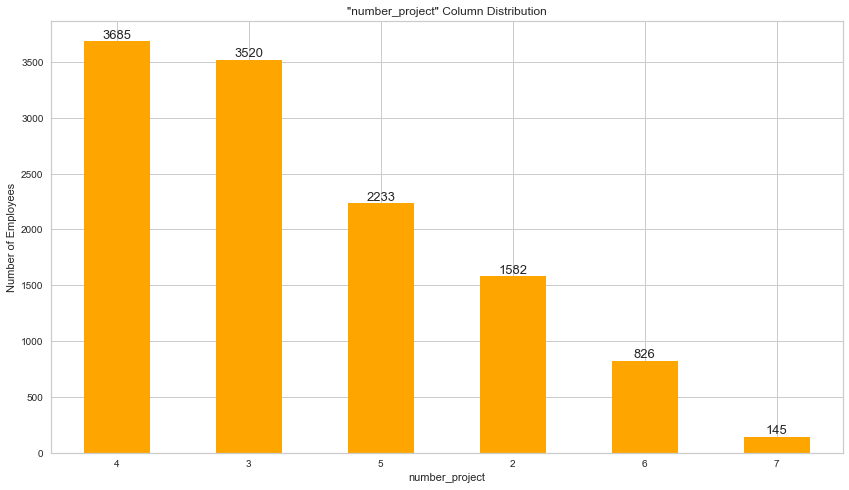

In [93]:
cprint('"number_project" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
# x = df.number_project.value_counts().index
# y = df.number_project.value_counts().values
df.number_project.value_counts().plot(kind = "bar", color = "orange")
plt.title('"number_project" Column Distribution')   
plt.xlabel('number_project') 
plt.ylabel('Number of Employees')
plt.xticks(rotation = 0)
for index,value in enumerate(df.number_project.value_counts().sort_values(ascending=False)):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### 5.3 - Time Spent in the Company
Similarly, you can also plot a bar graph to count the number of employees have based on how much experience?

In [94]:
cprint('"time_spend_company" Column Distribution','green')
df.time_spend_company.value_counts()

"time_spend_company" Column Distribution


3     5190
2     2910
4     2005
5     1062
6      542
10     107
7       94
8       81
Name: time_spend_company, dtype: int64

In [95]:
# with plotly

df['time_spend_company'].value_counts().iplot(kind="bar", title = '"time_spend_company" Column Distribution')

"time_spend_company" Column Distribution


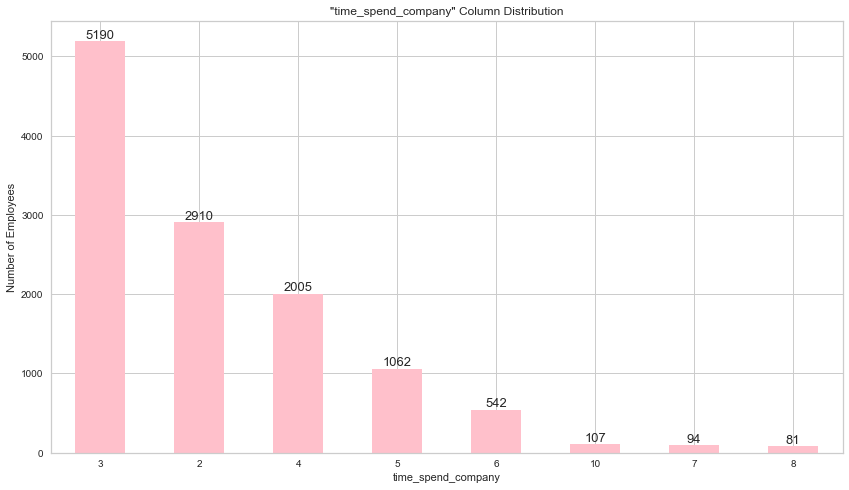

In [96]:
cprint('"time_spend_company" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
df.time_spend_company.value_counts().plot(kind = "bar", color = "pink")
plt.title('"time_spend_company" Column Distribution')   
plt.xlabel('time_spend_company') 
plt.ylabel('Number of Employees')
plt.xticks(rotation = 0)
for index,value in enumerate(df.time_spend_company.value_counts().sort_values(ascending=False)):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### 5.4 - Subplots of Features
You can use the methods of the matplotlib.

In [97]:
for i in df:
    df[i].iplot(kind = 'histogram', subplots = True, bins = 50)

## 6) DATA PRE-PROCESSING
Tasks in this section
- Label Encoding
- Scaling

### 6.1 - Label Encoding
Lots of machine learning algorithms require numerical input data, so you need to represent categorical columns in a numerical column. In order to encode this data, you could map each value to a number. e.g. Salary column's value can be represented as low:0, medium:1, and high:2. This process is known as label encoding, and sklearn conveniently will do this for you using LabelEncoder.

In [98]:
df1 = df.drop('left', axis = 1)
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary
0,0.380,0.530,2,157,3,0,0,sales,low
1,0.800,0.860,5,262,6,0,0,sales,medium
2,0.110,0.880,7,272,4,0,0,sales,medium
3,0.720,0.870,5,223,5,0,0,sales,low
4,0.370,0.520,2,159,3,0,0,sales,low


In [99]:
df1 = pd.get_dummies(df1, columns = ['department','salary'], drop_first = True)
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0


### 6.2 - Scalling

In [100]:
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0


In [101]:
scaler = MinMaxScaler()
scaler.fit(df1)

#Store it separately for clustering
df1_scaled= scaler.transform(df1)

In [102]:
df1_scaled

array([[0.31868132, 0.265625  , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.78021978, 0.78125   , 0.6       , ..., 0.        , 0.        ,
        1.        ],
       [0.02197802, 0.8125    , 1.        , ..., 0.        , 0.        ,
        1.        ],
       ...,
       [0.83516484, 0.28125   , 0.2       , ..., 0.        , 0.        ,
        0.        ],
       [0.26373626, 0.453125  , 0.2       , ..., 0.        , 0.        ,
        0.        ],
       [0.45054945, 0.578125  , 0.4       , ..., 0.        , 1.        ,
        0.        ]])

## 7) CLUSTER ANALYSIS

In [103]:
from pyclustertend import hopkins

hopkins(df1_scaled, df1.shape[0])

0.08290982186165713

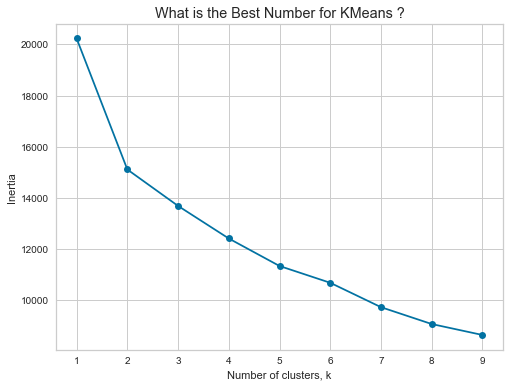

In [104]:
#First : Get the Best KMeans 
ks = range(1,10)
inertias=[]
for k in ks :
    # Create a KMeans clusters
    kc = KMeans(n_clusters=k,random_state=1)
    kc.fit(df1_scaled)
    inertias.append(kc.inertia_)

# Plot ks vs inertias
f, ax = plt.subplots(figsize=(8, 6))
plt.plot(ks, inertias, '-o')
plt.xlabel('Number of clusters, k')
plt.ylabel('Inertia')
plt.xticks(ks)
plt.style.use('ggplot')
plt.title('What is the Best Number for KMeans ?')
plt.show()

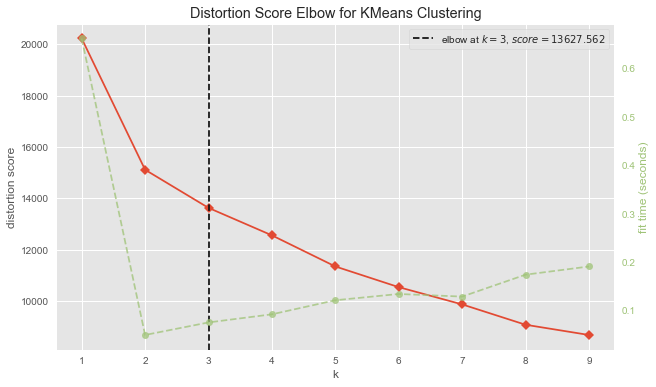

In [105]:
from yellowbrick.cluster import KElbowVisualizer

kmeans = KMeans()
visu = KElbowVisualizer(kmeans, k = (1,10))
visu.fit(df1_scaled)
visu.show();

In [106]:
from sklearn.metrics import silhouette_samples,silhouette_score

ssd =[]

K = range(2, 10)

for k in K:
    model = KMeans(n_clusters=k)
    model.fit(df1_scaled)
    ssd.append(model.inertia_)
    print(f'Silhouette Score for {k} clusters: {silhouette_score(df1_scaled, model.labels_)}')

Silhouette Score for 2 clusters: 0.24293849820807237
Silhouette Score for 3 clusters: 0.19250986825854602
Silhouette Score for 4 clusters: 0.17900983631836617
Silhouette Score for 5 clusters: 0.2169363940114809
Silhouette Score for 6 clusters: 0.24191814528938507
Silhouette Score for 7 clusters: 0.27407108356776877
Silhouette Score for 8 clusters: 0.29761183406668895
Silhouette Score for 9 clusters: 0.29571313798567606


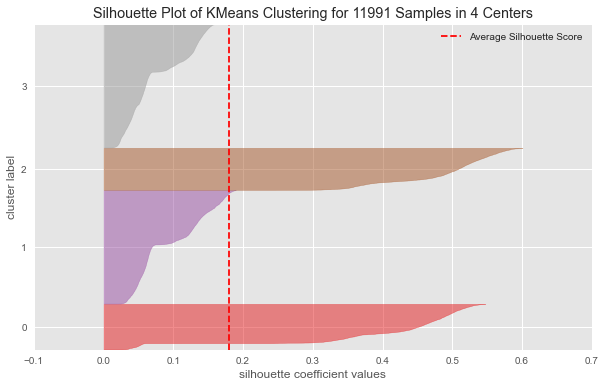

In [107]:
from sklearn.cluster import KMeans

from yellowbrick.cluster import SilhouetteVisualizer

model_4 = KMeans(n_clusters=4, random_state=101)
visualizer = SilhouetteVisualizer(model_4)
visualizer.fit(df1_scaled)    # Fit the data to the visualizer
visualizer.poof();

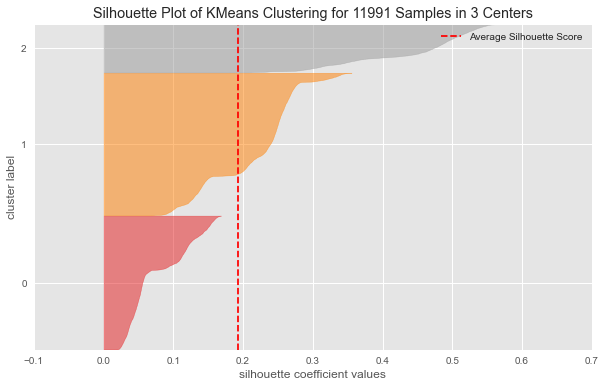

In [108]:
from sklearn.cluster import KMeans

from yellowbrick.cluster import SilhouetteVisualizer

model_3 = KMeans(n_clusters=3, random_state=101)
visualizer = SilhouetteVisualizer(model_3)
visualizer.fit(df1_scaled)    # Fit the data to the visualizer
visualizer.poof();

In [109]:
k_means_model = KMeans(n_clusters = 3, random_state = 101)
k_means_model.fit_predict(df1_scaled)
labels = k_means_model.labels_
labels

array([2, 1, 1, ..., 0, 0, 0])

In [110]:
df['predicted_clusters'] = labels
df

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left,predicted_clusters
0,0.380,0.530,2,157,3,0,0,sales,low,1,2
1,0.800,0.860,5,262,6,0,0,sales,medium,1,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1,1
3,0.720,0.870,5,223,5,0,0,sales,low,1,2
4,0.370,0.520,2,159,3,0,0,sales,low,1,2
...,...,...,...,...,...,...,...,...,...,...,...
11995,0.900,0.550,3,259,10,1,1,management,high,0,0
11996,0.740,0.950,5,266,10,0,1,management,high,0,0
11997,0.850,0.540,3,185,10,0,1,management,high,0,0
11998,0.330,0.650,3,172,10,0,1,marketing,high,0,0


In [111]:
df['predicted_clusters'].value_counts()

1    5261
0    4940
2    1790
Name: predicted_clusters, dtype: int64

In [112]:
fig = px.pie(df, values = df['predicted_clusters'].value_counts(), 
             names = (df['predicted_clusters'].value_counts()).index, 
             title = 'Predicted_Clusters Distribution')
fig.show()

In [113]:
fig = px.pie(df, values = df[df['left']==0]['predicted_clusters'].value_counts(), 
             names = df[df['left']==0]['predicted_clusters'].value_counts().index, 
             title = 'Predicted_Clusters_Almost_Lost Distribution')
fig.show()

In [114]:
fig = px.pie(df, values = df[df['left']==1]['predicted_clusters'].value_counts(), 
             names = df[df['left']==1]['predicted_clusters'].value_counts().index, 
             title = 'Predicted_Clusters_Almost_Lost Distribution')
fig.show()

In [115]:
pd.crosstab(df['left'], 
            df['predicted_clusters']).iplot(kind="bar", title = 'Compare (left vs predicted-clusters)',
            xTitle = 'left & clusters', yTitle = 'counts')

In [116]:
df.groupby('left').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,predicted_clusters
left,,,,,,,,
0,0.667,0.716,3.787,198.943,3.262,0.174,0.019,0.741
1,0.440,0.722,3.883,208.162,3.881,0.053,0.004,0.719


In [117]:
# cprint('Dataset describe results according to the "left==1" condition','green')

df.groupby(['left', 'predicted_clusters']).mean()

satisfaction_level  last_evaluation  number_project  \
left predicted_clusters                                                        
0    0                                0.667            0.720           3.787   
     1                                0.668            0.715           3.787   
     2                                0.667            0.707           3.787   
1    0                                0.430            0.721           3.912   
     1                                0.440            0.725           3.921   
     2                                0.470            0.716           3.719   

                         average_montly_hours  time_spend_company  \
left predicted_clusters                                             
0    0                                199.074               3.232   
     1                                199.016               3.304   
     2                                198.353               3.215   
1    0                                208.102               3.888   
     1                                209.765               3.891   
     2                                204.601               3.843   

                         work_accident  promotion_last_5years  
left predicted_clusters                                        
0    0                           0.184                  0.015  
     1                           0.169                  0.026  
     2                           0.168                  0.011  
1    0                           0.049                  0.003  
     1                           0.062                  0.004  
     2                           0.039                  0.006

In [118]:
pd.crosstab(df['predicted_clusters'], 
            df['left']).iplot(kind="bar", title = 'Compare (predicted-clusters vs left)',
            xTitle = 'clusters & left', yTitle = 'counts')

In [119]:
df.left.value_counts()

0    10000
1     1991
Name: left, dtype: int64

In [120]:
# cprint('Dataset describe results according to the "left==1" condition','green')

df.groupby('predicted_clusters').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left
predicted_clusters,,,,,,,,
0,0.624,0.720,3.810,200.702,3.350,0.159,0.013,0.180
1,0.635,0.717,3.806,200.587,3.390,0.153,0.023,0.146
2,0.631,0.708,3.774,199.508,3.331,0.144,0.010,0.185


In [121]:
# cprint('Dataset describe results according to the "left==1" condition','green')

df.groupby(['predicted_clusters', 'left']).mean()

satisfaction_level  last_evaluation  number_project  \
predicted_clusters left                                                        
0                  0                  0.667            0.720           3.787   
                   1                  0.430            0.721           3.912   
1                  0                  0.668            0.715           3.787   
                   1                  0.440            0.725           3.921   
2                  0                  0.667            0.707           3.787   
                   1                  0.470            0.716           3.719   

                         average_montly_hours  time_spend_company  \
predicted_clusters left                                             
0                  0                  199.074               3.232   
                   1                  208.102               3.888   
1                  0                  199.016               3.304   
                   1                  209.765               3.891   
2                  0                  198.353               3.215   
                   1                  204.601               3.843   

                         work_accident  promotion_last_5years  
predicted_clusters left                                        
0                  0             0.184                  0.015  
                   1             0.049                  0.003  
1                  0             0.169                  0.026  
                   1             0.062                  0.004  
2                  0             0.168                  0.011  
                   1             0.039                  0.006

## 8) MODEL BUILDING

In [122]:
df2 = df.drop('predicted_clusters', axis = 1)
df2.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left
0,0.380,0.530,2,157,3,0,0,sales,low,1
1,0.800,0.860,5,262,6,0,0,sales,medium,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1
3,0.720,0.870,5,223,5,0,0,sales,low,1
4,0.370,0.520,2,159,3,0,0,sales,low,1


In [123]:
df2 = pd.get_dummies(df2, columns = ['department','salary'], drop_first = True)
df2.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,1,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,1,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,1,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0


### 8.1 - Spliting Data as Train & Test

In [124]:
X = df2.drop('left', axis = 1)
y = df2['left']

In [125]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify = y, test_size = 0.3, random_state = 101)

In [126]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [127]:
def eval(model, X_train, X_test):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    
    print(confusion_matrix(y_test, y_pred))
    print("Test_Set")
    print(classification_report(y_test,y_pred))
    print("Train_Set")
    print(classification_report(y_train,y_pred_train))
    plot_confusion_matrix(model, X_test, y_test, cmap="plasma")

In [128]:
def train_val(y_train, y_train_pred, y_test, y_pred):
    
    scores = {"train_set": {"Accuracy" : accuracy_score(y_train, y_train_pred),
                            "Precision" : precision_score(y_train, y_train_pred),
                            "Recall" : recall_score(y_train, y_train_pred),                          
                            "f1" : f1_score(y_train, y_train_pred)},
    
              "test_set": {"Accuracy" : accuracy_score(y_test, y_pred),
                           "Precision" : precision_score(y_test, y_pred),
                           "Recall" : recall_score(y_test, y_pred),                          
                           "f1" : f1_score(y_test, y_pred)}}
    
    return pd.DataFrame(scores)

### 8.2 - Best Model Scores With PyCaret

In [129]:
# !pip install pycaret
# !conda install --user pycaret 
# !pip install git+https://github.com/pycaret/pycaret.git #egg=pycaret

In [130]:
# from pycaret.classification import *

# employee_clf = setup(df2, target = 'left', 
#                      session_id = 123, 
#                      train_size=0.8, 
#                      log_experiment=True, 
#                      log_plots=True, 
#                      experiment_name = 'employee_churn_model')

In [131]:
# best_model_scores = compare_models()

## 8.3 - Gradient Boosting Classifier
### 8.3.1 Model Building

In [132]:
GB_model = GradientBoostingClassifier(random_state = 101)
GB_model.fit(X_train, y_train)
y_pred = GB_model.predict(X_test)
y_train_pred = GB_model.predict(X_train)

GB_model_f1 = f1_score(y_test, y_pred)
GB_model_acc = accuracy_score(y_test, y_pred)
GB_model_recall = recall_score(y_test, y_pred)
GB_model_auc = roc_auc_score(y_test, y_pred)

<IPython.core.display.Javascript object>

### 8.3.2 Evaluating Model Performance

GB_Model
------------------
[[2974   27]
 [  45  552]]
Test_Set
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      3001
           1       0.95      0.92      0.94       597

    accuracy                           0.98      3598
   macro avg       0.97      0.96      0.96      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      6999
           1       0.97      0.93      0.95      1394

    accuracy                           0.98      8393
   macro avg       0.98      0.96      0.97      8393
weighted avg       0.98      0.98      0.98      8393



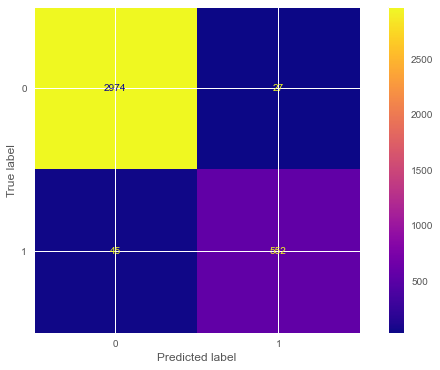

In [133]:
print("GB_Model")
print ("------------------")
eval(GB_model, X_train, X_test)

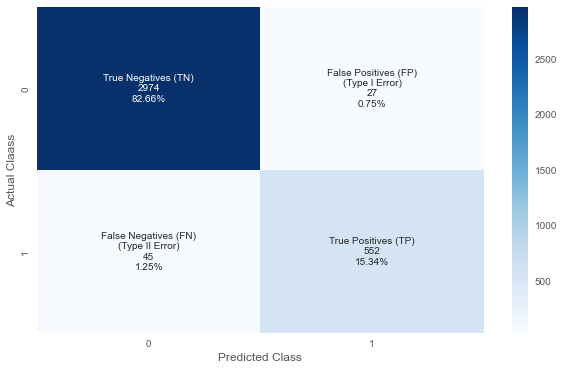

In [134]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

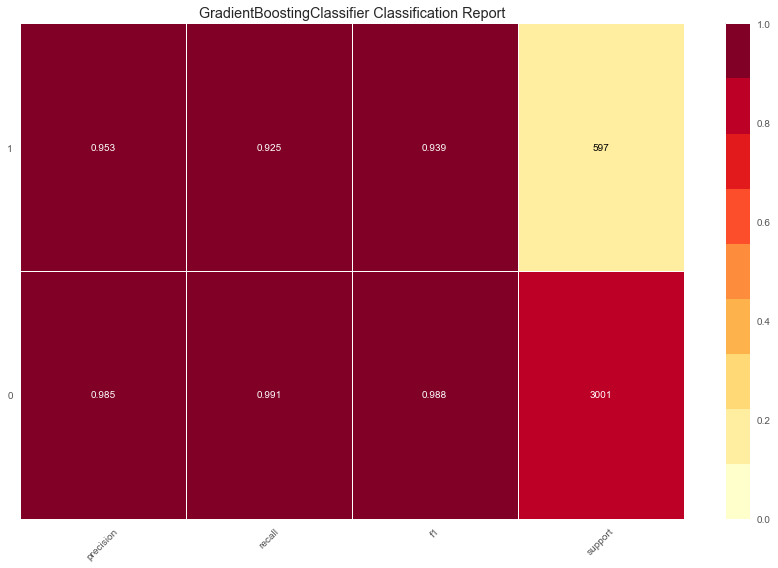

<AxesSubplot:title={'center':'GradientBoostingClassifier Classification Report'}>

In [135]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(GB_model, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [136]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.983,0.980
Precision,0.969,0.953
Recall,0.928,0.925
f1,0.948,0.939


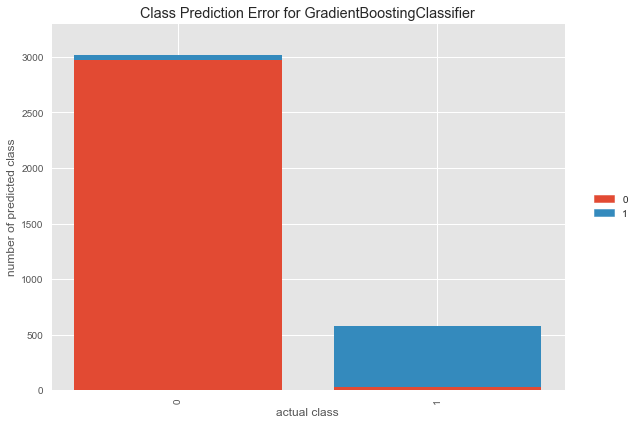

In [137]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(GB_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.3.3 Feature Importance for Gradient Boosting Model

In [138]:
GB_feature_imp = pd.DataFrame(index=X.columns, data = GB_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
GB_feature_imp

,Importance
satisfaction_level,0.527
number_project,0.138
time_spend_company,0.137
last_evaluation,0.122
average_montly_hours,0.075
salary_low,0.001
work_accident,0.000
department_management,0.000
department_product_mng,0.000
department_RandD,0.000


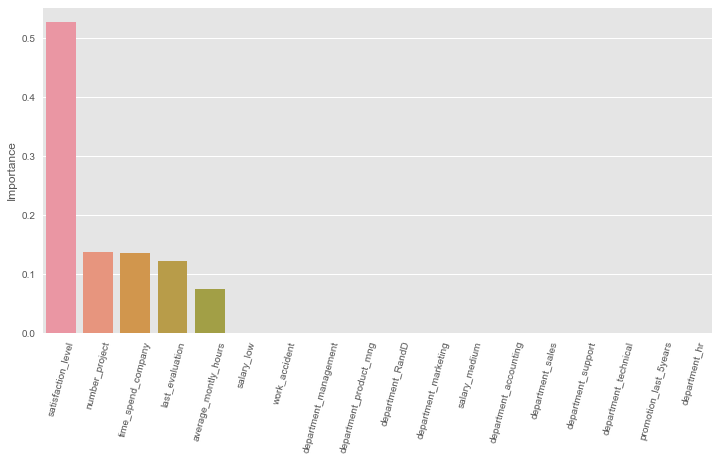

In [139]:
plt.figure(figsize = (12,6))
sns.barplot(data = GB_feature_imp.sort_values('Importance', ascending = False), x = GB_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

### 8.3.4 Gradient Boosting Classifier Cross Validation

In [140]:
GB_cv = GradientBoostingClassifier(random_state = 101)

GB_cv_scores = cross_validate(GB_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
GB_cv_scores = pd.DataFrame(GB_cv_scores, index = range(1, 11))

GB_cv_scores.mean()[2:]

<IPython.core.display.Javascript object>

test_accuracy    0.981
test_precision   0.965
test_recall      0.922
test_f1          0.943
test_roc_auc     0.985
dtype: float64

# 8.3.5 Gradient Boosting Classifier GridSearchCV

In [141]:
param_grid = {"n_estimators":[100, 200, 300],
              "subsample":[0.5, 1], 
              "max_features" : [None, 2, 3, 4],
              "learning_rate": [0.001, 0.01, 0.1], 
              'max_depth':[3, 4, 5, 6]} 

In [142]:
GB_grid = GradientBoostingClassifier(random_state = 101)
GB_grid_model = GridSearchCV(GB_grid, param_grid, scoring = "f1", verbose = 0, n_jobs = -1).fit(X_train, y_train)

<IPython.core.display.Javascript object>

In [143]:
GB_grid_model.best_estimator_

GradientBoostingClassifier(learning_rate=0.01, max_depth=6, n_estimators=200,
                           random_state=101, subsample=0.5)

In [144]:
print(colored('\033[1mBest Parameters of GridSearchCV for Gradient Boosting Model:\033[0m', 'blue'), colored(GB_grid_model.best_params_, 'cyan'))
print("--------------------------------------------------------------------------------------------------------------------")
print(colored('\033[1mBest Estimator of GridSearchCV for Gradient Boosting Model:\033[0m', 'blue'), colored(GB_grid_model.best_estimator_, 'cyan'))

Best Parameters of GridSearchCV for Gradient Boosting Model: {'learning_rate': 0.01, 'max_depth': 6, 'max_features': None, 'n_estimators': 200, 'subsample': 0.5}
--------------------------------------------------------------------------------------------------------------------
Best Estimator of GridSearchCV for Gradient Boosting Model: GradientBoostingClassifier(learning_rate=0.01, max_depth=6, n_estimators=200,
                           random_state=101, subsample=0.5)


In [145]:
GB_tuned = GradientBoostingClassifier(learning_rate = 0.01,
                                      max_depth = 6, 
                                      n_estimators = 200,
                                      subsample = 0.5,
                                      random_state = 101).fit(X_train, y_train)

<IPython.core.display.Javascript object>

In [146]:
y_pred = GB_tuned.predict(X_test)
y_train_pred = GB_tuned.predict(X_train)

GB_tuned_f1 = f1_score(y_test, y_pred)
GB_tuned_acc = accuracy_score(y_test, y_pred)
GB_tuned_recall = recall_score(y_test, y_pred)
GB_tuned_auc = roc_auc_score(y_test, y_pred)

GB_tuned
------------------
[[2994    7]
 [  48  549]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      3001
           1       0.99      0.92      0.95       597

    accuracy                           0.98      3598
   macro avg       0.99      0.96      0.97      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      6999
           1       0.99      0.93      0.96      1394

    accuracy                           0.99      8393
   macro avg       0.99      0.96      0.97      8393
weighted avg       0.99      0.99      0.99      8393



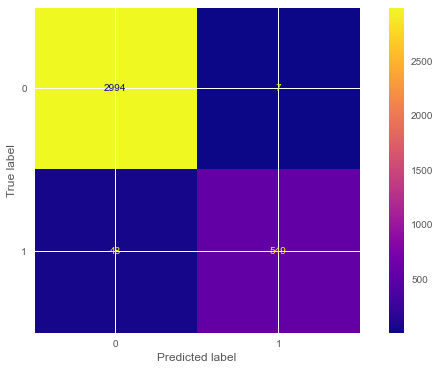

In [147]:
print("GB_tuned")
print ("------------------")
eval(GB_tuned, X_train, X_test)

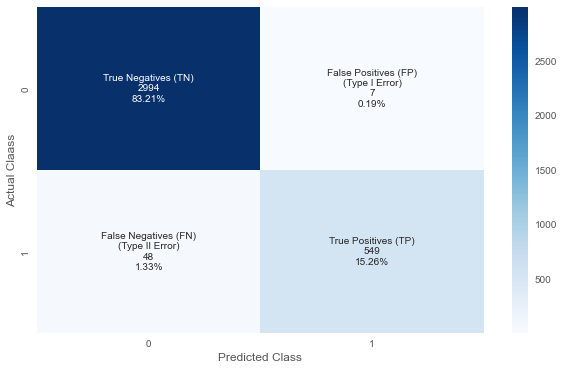

In [148]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

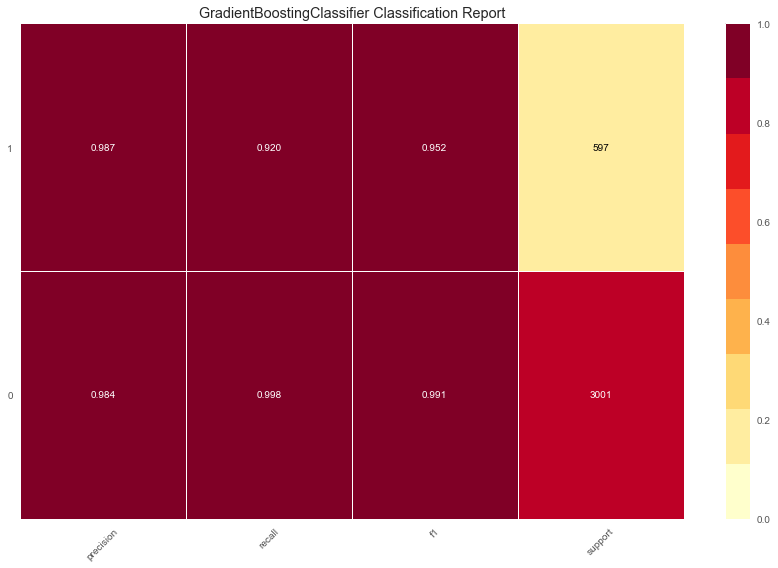

<AxesSubplot:title={'center':'GradientBoostingClassifier Classification Report'}>

In [149]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(GB_tuned, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [150]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.986,0.985
Precision,0.989,0.987
Recall,0.926,0.920
f1,0.957,0.952


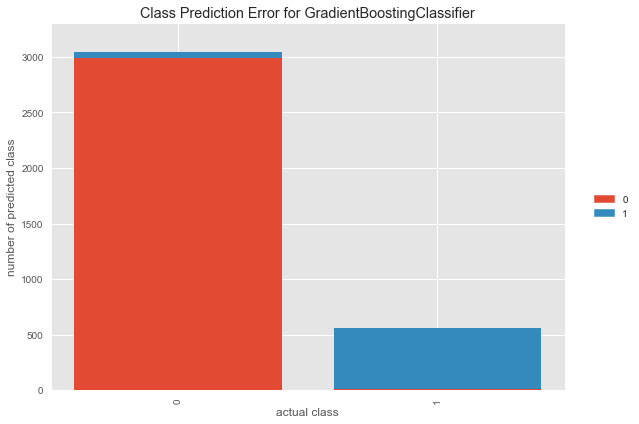

In [151]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(GB_tuned)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.3.6 Gradient Boosting Classifier ROC (Receiver Operating Curve) & AUC (Area Under Curve)

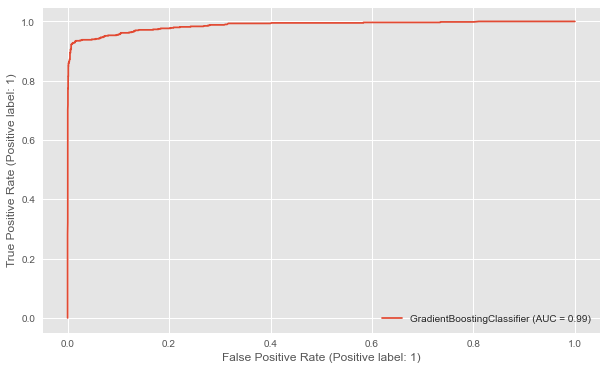

In [152]:
plot_roc_curve(GB_model, X_test, y_test);

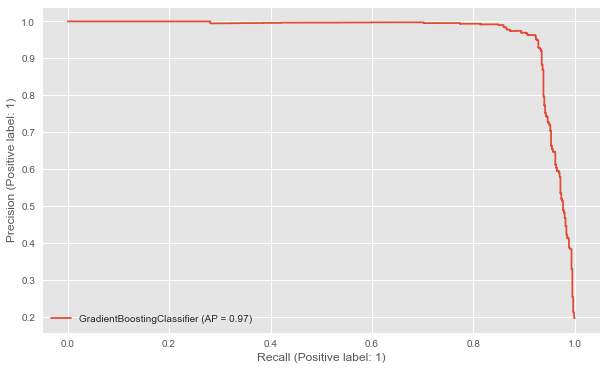

In [153]:
plot_precision_recall_curve(GB_model, X_test, y_test);

### 8.3.7 Prediction

In [154]:
GB_Pred = {"Actual": y_test, "GB_Pred":y_pred}
GB_Pred = pd.DataFrame.from_dict(GB_Pred)
GB_Pred.head(20)

,Actual,GB_Pred
3118,0,0
10490,0,0
1106,1,1
3822,0,0
6873,0,0
9581,0,0
9712,0,0
8794,0,0
4830,0,0
179,1,1


In [155]:
Model_Preds = GB_Pred
Model_Preds.head()

,Actual,GB_Pred
3118,0,0
10490,0,0
1106,1,1
3822,0,0
6873,0,0


## 8.4 - KNeighbors Classifier
### 8.4.1 Model Building

In [156]:
KNN_model = KNeighborsClassifier(n_neighbors = 5)
KNN_model.fit(X_train, y_train)
y_pred = KNN_model.predict(X_test)
y_train_pred = KNN_model.predict(X_train)

KNN_model_f1 = f1_score(y_test, y_pred)
KNN_model_acc = accuracy_score(y_test, y_pred)
KNN_model_recall = recall_score(y_test, y_pred)
KNN_model_auc = roc_auc_score(y_test, y_pred)

### 8.4.2 Evaluating Model Performance

KNN_Model
------------------
[[2883  118]
 [  83  514]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      3001
           1       0.81      0.86      0.84       597

    accuracy                           0.94      3598
   macro avg       0.89      0.91      0.90      3598
weighted avg       0.95      0.94      0.94      3598

Train_Set
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      6999
           1       0.88      0.88      0.88      1394

    accuracy                           0.96      8393
   macro avg       0.93      0.93      0.93      8393
weighted avg       0.96      0.96      0.96      8393



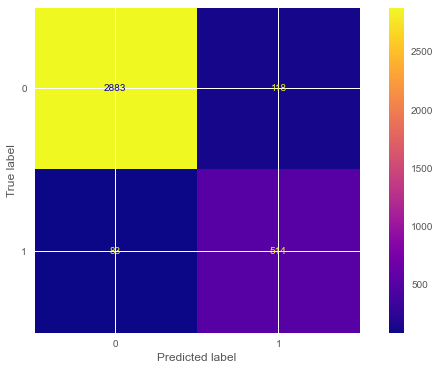

In [157]:
print("KNN_Model")
print ("------------------")
eval(KNN_model, X_train, X_test)

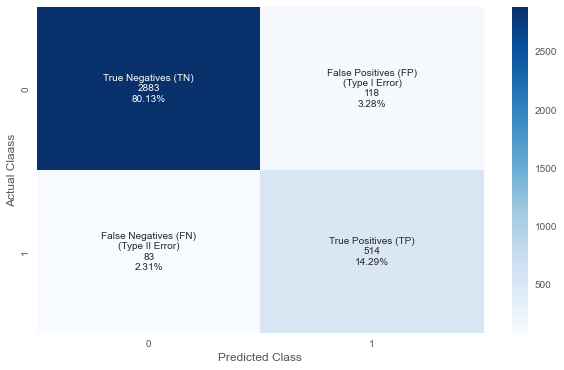

In [158]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

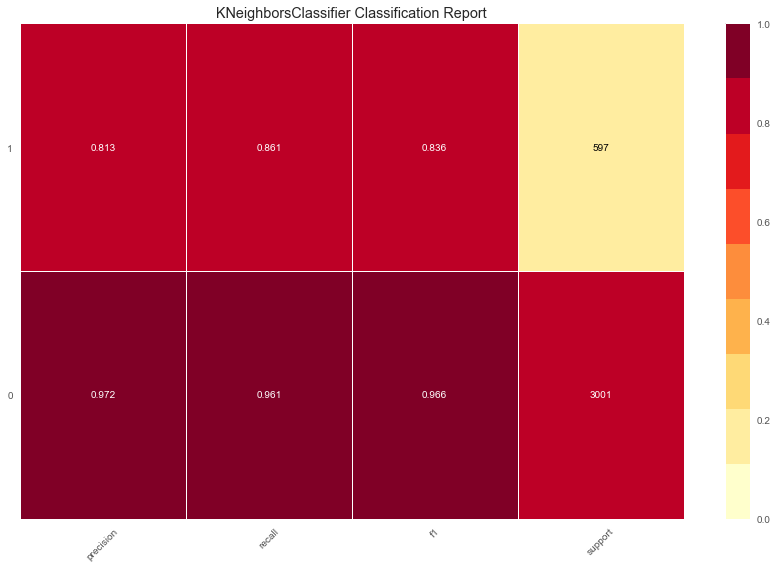

<AxesSubplot:title={'center':'KNeighborsClassifier Classification Report'}>

In [159]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(KNN_model, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [160]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.960,0.944
Precision,0.879,0.813
Recall,0.878,0.861
f1,0.879,0.836


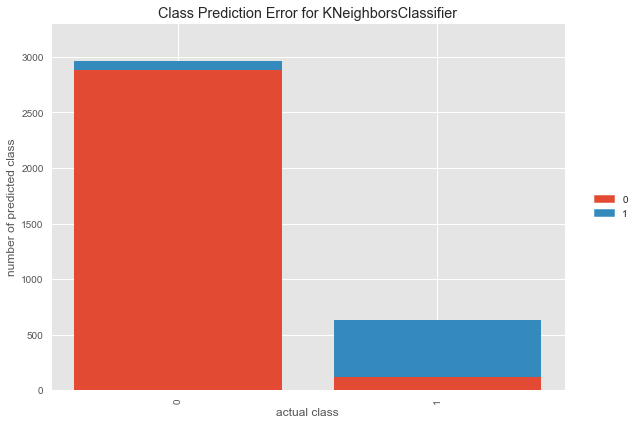

In [161]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(KNN_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.4.3 KNeighbors Classifier Cross Validation

In [162]:
KNN_cv = KNeighborsClassifier(n_neighbors = 5)

KNN_cv_scores = cross_validate(KNN_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
KNN_cv_scores = pd.DataFrame(KNN_cv_scores, index = range(1, 11))

KNN_cv_scores.mean()[2:]

test_accuracy    0.948
test_precision   0.835
test_recall      0.859
test_f1          0.846
test_roc_auc     0.943
dtype: float64

### 8.4.4 Elbow Method for Choosing Reasonable K Values

[0.053362979433018376, 0.04307948860478039, 0.053085047248471406, 0.04558087826570312, 0.0558643690939411, 0.05141745414118959, 0.05697609783212898, 0.05669816564758201, 0.06142301278488049, 0.060867148415786554, 0.06475819899944413, 0.06698165647581988, 0.07031684269038352, 0.0714285714285714, 0.07559755419677594, 0.07448582545858806, 0.07809894385769867, 0.07865480822679272, 0.08032240133407453, 0.08282379099499726, 0.08393551973318514, 0.08643690939410786, 0.0861589772095609, 0.08893829905503059, 0.09032795997776544, 0.09088382434685938, 0.0933852140077821, 0.09310728182323513, 0.09366314619232907]


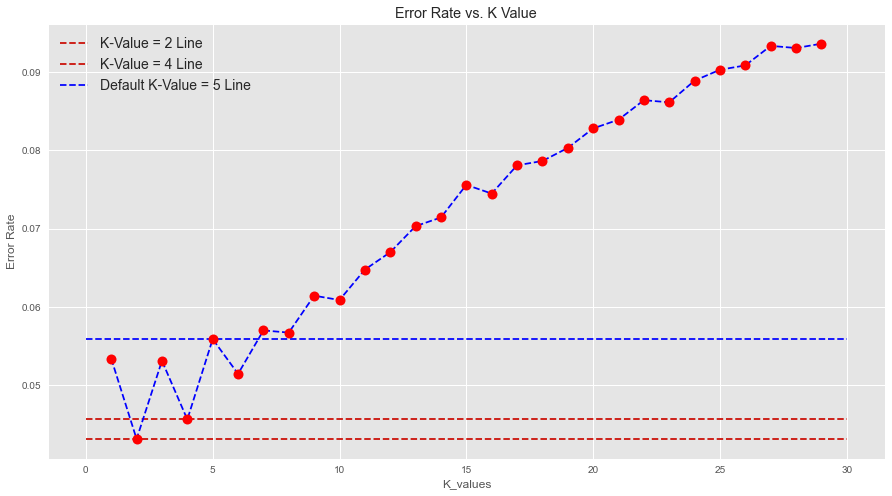

In [163]:
test_error_rates = []

for k in range(1, 30):
    KNN = KNeighborsClassifier(n_neighbors = k)
    KNN.fit(X_train, y_train) 
   
    y_pred = KNN.predict(X_test)
    
    test_error = 1 - accuracy_score(y_test, y_pred)
    test_error_rates.append(test_error)
    
print(test_error_rates)

plt.figure(figsize = (15, 8))
plt.plot(range(1, 30), test_error_rates, color = 'blue', linestyle = '--', marker = 'o',
         markerfacecolor = 'red', markersize = 10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K_values')
plt.ylabel('Error Rate')

plt.hlines(y = 0.04307948860478039, xmin = 0, xmax = 30, colors = 'r', linestyles = "--", label = "K-Value = 2 Line")
plt.hlines(y = 0.04558087826570312, xmin = 0, xmax = 30, colors = 'r', linestyles = "--", label = "K-Value = 4 Line")
plt.hlines(y = 0.055864369093941, xmin = 0, xmax = 30, colors = 'blue', linestyles = "--", label = "Default K-Value = 5 Line")
plt.legend(prop = {"size":14});

In [164]:
# FIRST A QUICK COMPARISON TO OUR DEFAULT K=5

knn5 = KNeighborsClassifier(n_neighbors = 5)

knn5.fit(X_train,y_train)
pred = knn5.predict(X_test)

print('WITH K=5')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=5
---------------
[[2883  118]
 [  83  514]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      3001
           1       0.81      0.86      0.84       597

    accuracy                           0.94      3598
   macro avg       0.89      0.91      0.90      3598
weighted avg       0.95      0.94      0.94      3598



In [165]:
# NOW K=2

knn2 = KNeighborsClassifier(n_neighbors = 2)

knn2.fit(X_train,y_train)
pred = knn2.predict(X_test)

print('WITH K=2')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=2
---------------
[[2951   50]
 [ 105  492]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      3001
           1       0.91      0.82      0.86       597

    accuracy                           0.96      3598
   macro avg       0.94      0.90      0.92      3598
weighted avg       0.96      0.96      0.96      3598



In [166]:
# NOW K=4

knn4 = KNeighborsClassifier(n_neighbors = 4)

knn4.fit(X_train,y_train)
pred = knn4.predict(X_test)

print('WITH K=4')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=4
---------------
[[2929   72]
 [  92  505]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      3001
           1       0.88      0.85      0.86       597

    accuracy                           0.95      3598
   macro avg       0.92      0.91      0.92      3598
weighted avg       0.95      0.95      0.95      3598



In [167]:
# NOW K=6

knn6 = KNeighborsClassifier(n_neighbors = 6)

knn6.fit(X_train,y_train)
pred = knn6.predict(X_test)

print('WITH K=6')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=6
---------------
[[2905   96]
 [  89  508]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      3001
           1       0.84      0.85      0.85       597

    accuracy                           0.95      3598
   macro avg       0.91      0.91      0.91      3598
weighted avg       0.95      0.95      0.95      3598



In [168]:
# NOW K=8

knn8 = KNeighborsClassifier(n_neighbors = 8)

knn8.fit(X_train,y_train)
pred = knn8.predict(X_test)

print('WITH K=8')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=8
---------------
[[2903   98]
 [ 106  491]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.97      0.97      3001
           1       0.83      0.82      0.83       597

    accuracy                           0.94      3598
   macro avg       0.90      0.89      0.90      3598
weighted avg       0.94      0.94      0.94      3598



In [169]:
# NOW K=10

knn10 = KNeighborsClassifier(n_neighbors = 10)

knn10.fit(X_train,y_train)
pred = knn10.predict(X_test)

print('WITH K=10')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=10
---------------
[[2898  103]
 [ 116  481]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.97      0.96      3001
           1       0.82      0.81      0.81       597

    accuracy                           0.94      3598
   macro avg       0.89      0.89      0.89      3598
weighted avg       0.94      0.94      0.94      3598



### 8.4.5 KNeighbors Classifier GridsearchCV for Choosing Reasonable K Values

In [170]:
k_values = range(1, 30)
param_grid = {"n_neighbors": k_values, "p": [1, 2], "weights": ['uniform', "distance"]}
KNN_grid = KNeighborsClassifier()
KNN_grid_model = GridSearchCV(KNN_grid, param_grid, cv = 10, scoring = 'recall')  
KNN_grid_model.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': range(1, 30), 'p': [1, 2],
                         'weights': ['uniform', 'distance']},
             scoring='recall')

In [171]:
KNN_grid_model.best_estimator_

KNeighborsClassifier(n_neighbors=3, p=1, weights='distance')

In [172]:
print(colored('\033[1mBest Parameters of GridSearchCV for KNN Model:\033[0m', 'blue'), colored(KNN_grid_model.best_params_, 'cyan'))
print("--------------------------------------------------------------------------------------------------------------------")
print(colored('\033[1mBest Estimator of GridSearchCV for KNN Model:\033[0m', 'blue'), colored(KNN_grid_model.best_estimator_, 'cyan'))

Best Parameters of GridSearchCV for KNN Model: {'n_neighbors': 3, 'p': 1, 'weights': 'distance'}
--------------------------------------------------------------------------------------------------------------------
Best Estimator of GridSearchCV for KNN Model: KNeighborsClassifier(n_neighbors=3, p=1, weights='distance')


KNN_tuned (K=3)
------------------
[[2898  103]
 [  79  518]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      3001
           1       0.83      0.87      0.85       597

    accuracy                           0.95      3598
   macro avg       0.90      0.92      0.91      3598
weighted avg       0.95      0.95      0.95      3598

Train_Set
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      6999
           1       0.91      0.91      0.91      1394

    accuracy                           0.97      8393
   macro avg       0.94      0.94      0.94      8393
weighted avg       0.97      0.97      0.97      8393



,train_set,test_set
Accuracy,0.969,0.949
Precision,0.909,0.834
Recall,0.906,0.868
f1,0.907,0.851


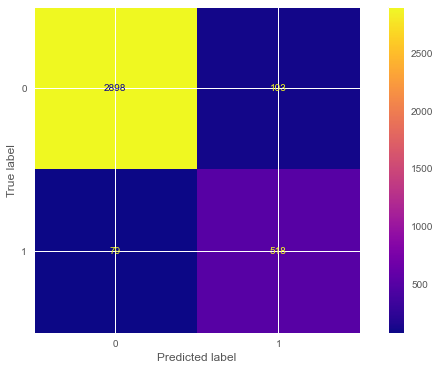

In [173]:
# NOW WITH K=3

KNN_tuned3 = KNeighborsClassifier(n_neighbors = 3, p = 1)
KNN_tuned3.fit(X_train, y_train)
y_pred = KNN_tuned3.predict(X_test)
y_train_pred = KNN_tuned3.predict(X_train)

KNN_tuned3_f1 = f1_score(y_test, y_pred)
KNN_tuned3_acc = accuracy_score(y_test, y_pred)
KNN_tuned3_recall = recall_score(y_test, y_pred)
KNN_tuned3_auc = roc_auc_score(y_test, y_pred)

print("KNN_tuned (K=3)")
print ("------------------")
eval(KNN_tuned3, X_train, X_test)
train_val(y_train, y_train_pred, y_test, y_pred)

KNN_tuned (K=1)
------------------
[[2882  119]
 [  84  513]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      3001
           1       0.81      0.86      0.83       597

    accuracy                           0.94      3598
   macro avg       0.89      0.91      0.90      3598
weighted avg       0.95      0.94      0.94      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       1.00      1.00      1.00      1394

    accuracy                           1.00      8393
   macro avg       1.00      1.00      1.00      8393
weighted avg       1.00      1.00      1.00      8393



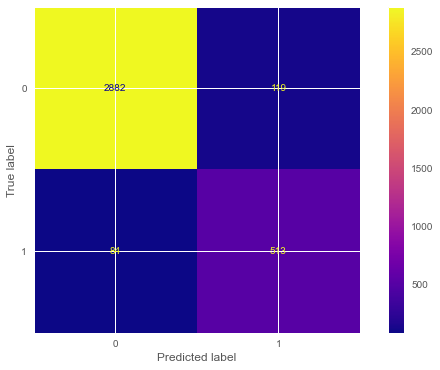

In [174]:
# NOW WITH K=1

KNN_tuned1 = KNeighborsClassifier(n_neighbors = 1, p = 1)
KNN_tuned1.fit(X_train, y_train)
y_pred = KNN_tuned1.predict(X_test)
y_train_pred = KNN_tuned1.predict(X_train)

KNN_tuned1_f1 = f1_score(y_test, y_pred)
KNN_tuned1_acc = accuracy_score(y_test, y_pred)
KNN_tuned1_recall = recall_score(y_test, y_pred)
KNN_tuned1_auc = roc_auc_score(y_test, y_pred)

print("KNN_tuned (K=1)")
print ("------------------")
eval(KNN_tuned1, X_train, X_test)

### 8.4.6 KNeighbors Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

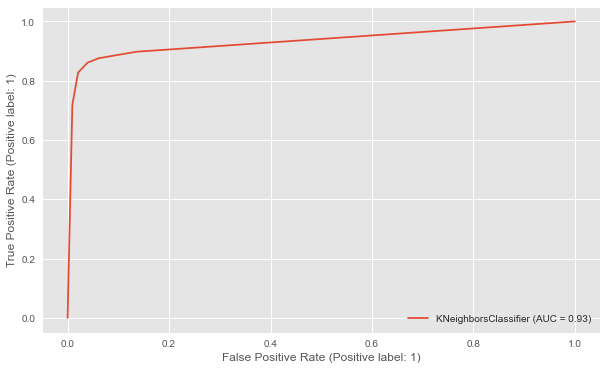

In [175]:
plot_roc_curve(KNN_model, X_test, y_test);

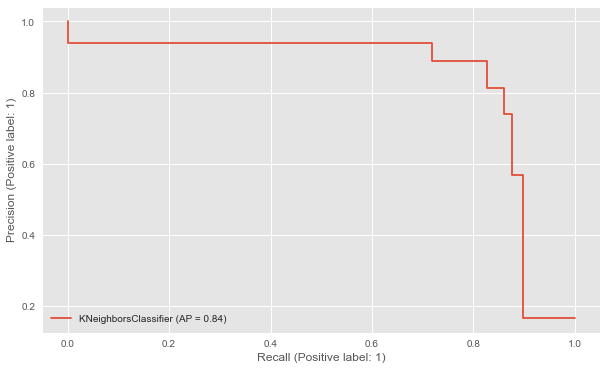

In [176]:
plot_precision_recall_curve(KNN_model, X_test, y_test);

### 8.4.7 Prediction

In [177]:
KNN_Pred = {"Actual": y_test, "KNN_Pred":y_pred}
KNN_Pred = pd.DataFrame.from_dict(KNN_Pred)
KNN_Pred.head(20)

,Actual,KNN_Pred
3118,0,0
10490,0,0
1106,1,1
3822,0,0
6873,0,0
9581,0,0
9712,0,0
8794,0,0
4830,0,0
179,1,1


In [178]:
KNN_Pred.drop("Actual", axis = 1, inplace = True)
Model_Preds = pd.merge(Model_Preds, KNN_Pred, left_index = True, right_index = True)
Model_Preds.head(20)

,Actual,GB_Pred,KNN_Pred
3118,0,0,0
10490,0,0,0
1106,1,1,1
3822,0,0,0
6873,0,0,0
9581,0,0,0
9712,0,0,0
8794,0,0,0
4830,0,0,0
179,1,1,1


### 8.5 - Random Forest Classifier

### 8.5.1 Model Building

In [179]:
RF_model = RandomForestClassifier(class_weight = "balanced", random_state = 101)
RF_model.fit(X_train, y_train)
y_pred = RF_model.predict(X_test)
y_train_pred = RF_model.predict(X_train)

RF_model_f1 = f1_score(y_test, y_pred)
RF_model_acc = accuracy_score(y_test, y_pred)
RF_model_recall = recall_score(y_test, y_pred)
RF_model_auc = roc_auc_score(y_test, y_pred)

### 8.5.2 Evaluating Model Performance

RF_Model
------------------
[[2996    5]
 [  58  539]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      3001
           1       0.99      0.90      0.94       597

    accuracy                           0.98      3598
   macro avg       0.99      0.95      0.97      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       1.00      1.00      1.00      1394

    accuracy                           1.00      8393
   macro avg       1.00      1.00      1.00      8393
weighted avg       1.00      1.00      1.00      8393



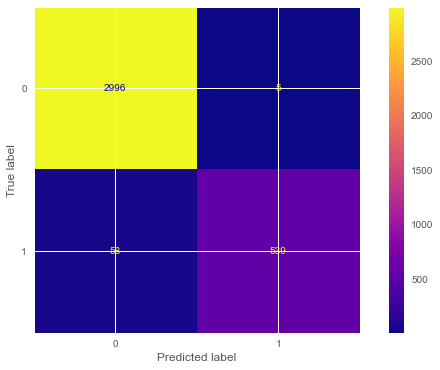

In [180]:
print("RF_Model")
print ("------------------")
eval(RF_model, X_train, X_test)

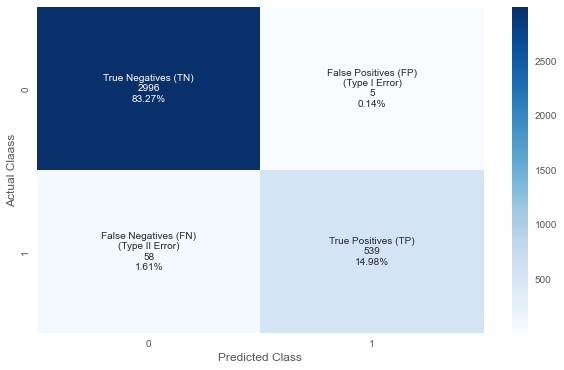

In [181]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

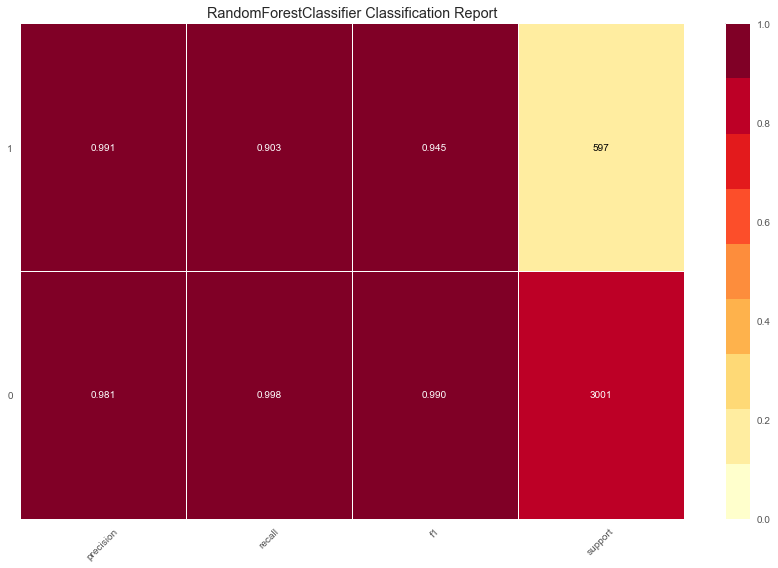

<AxesSubplot:title={'center':'RandomForestClassifier Classification Report'}>

In [182]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(RF_model, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [183]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,1.000,0.982
Precision,1.000,0.991
Recall,1.000,0.903
f1,1.000,0.945


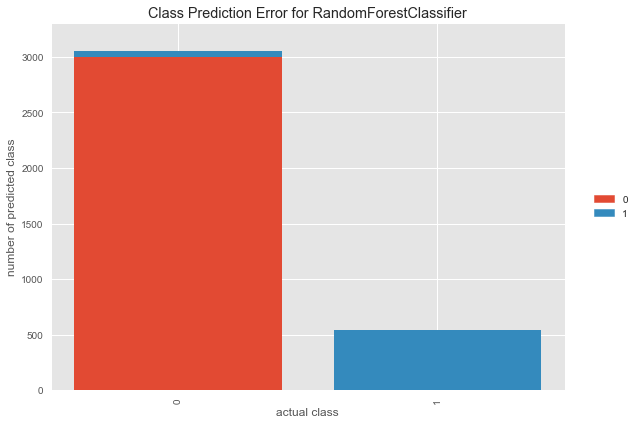

In [184]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(RF_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.5.3 Feature Importance for Random Forest Model

In [185]:
RF_feature_imp = pd.DataFrame(index=X.columns, data = RF_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
RF_feature_imp

,Importance
satisfaction_level,0.282
time_spend_company,0.240
average_montly_hours,0.167
number_project,0.133
last_evaluation,0.132
work_accident,0.011
salary_low,0.007
salary_medium,0.004
department_sales,0.004
department_technical,0.004


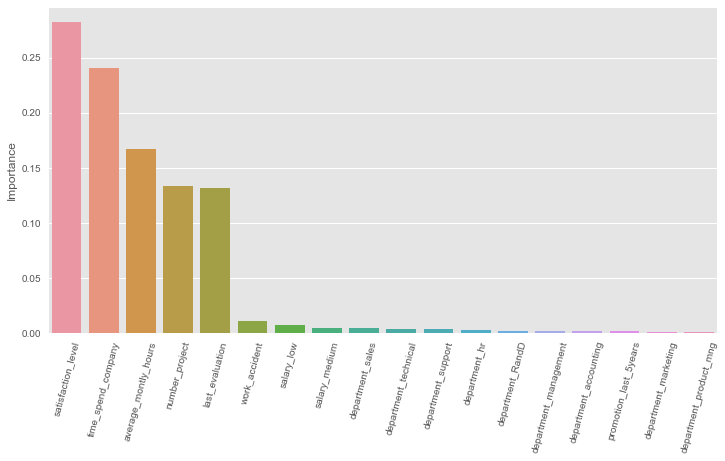

In [186]:
plt.figure(figsize = (12,6))
sns.barplot(data = RF_feature_imp.sort_values('Importance', ascending = False), x = RF_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

### 8.5.4 Random Forest Classifier Cross Validation

In [187]:
RF_cv = RandomForestClassifier(class_weight = "balanced", random_state = 101)

RF_cv_scores = cross_validate(RF_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
RF_cv_scores = pd.DataFrame(RF_cv_scores, index = range(1, 11))

RF_cv_scores.mean()[2:]

test_accuracy    0.982
test_precision   0.988
test_recall      0.905
test_f1          0.944
test_roc_auc     0.980
dtype: float64

### 8.5.5 Random Forest Classifier GridSearchCV

In [188]:
param_grid = {'n_estimators' : [50, 100, 300],
             'max_features' : [2, 3, 4],
             'max_depth' : [3, 5, 7, 9],
             'min_samples_split' : [2, 5, 8]}

In [189]:
RF_grid = RandomForestClassifier(class_weight = 'balanced', random_state = 101)
RF_grid_model = GridSearchCV(estimator = RF_grid, 
                             param_grid = param_grid, 
                             scoring = "recall", 
                             n_jobs = -1, verbose = 0)
RF_grid_model.fit(X_train, y_train)

GridSearchCV(estimator=RandomForestClassifier(class_weight='balanced',
                                              random_state=101),
             n_jobs=-1,
             param_grid={'max_depth': [3, 5, 7, 9], 'max_features': [2, 3, 4],
                         'min_samples_split': [2, 5, 8],
                         'n_estimators': [50, 100, 300]},
             scoring='recall')

In [190]:
RF_grid_model.best_estimator_

RandomForestClassifier(class_weight='balanced', max_depth=3, max_features=4,
                       n_estimators=300, random_state=101)

In [191]:
print(colored('\033[1mBest Parameters of GridSearchCV for Random Forest Model:\033[0m', 'blue'), colored(RF_grid_model.best_params_, 'cyan'))
print("--------------------------------------------------------------------------------------------------------------------")
print(colored('\033[1mBest Estimator of GridSearchCV for Random Forest Model:\033[0m', 'blue'), colored(RF_grid_model.best_estimator_, 'cyan'))

Best Parameters of GridSearchCV for Random Forest Model: {'max_depth': 3, 'max_features': 4, 'min_samples_split': 2, 'n_estimators': 300}
--------------------------------------------------------------------------------------------------------------------
Best Estimator of GridSearchCV for Random Forest Model: RandomForestClassifier(class_weight='balanced', max_depth=3, max_features=4,
                       n_estimators=300, random_state=101)


In [192]:
RF_tuned = RandomForestClassifier(class_weight = 'balanced',
                                  max_depth = 3,
                                  max_features = 4,
                                  n_estimators = 300,
                                  random_state = 101).fit(X_train, y_train)

In [193]:
y_pred = RF_tuned.predict(X_test)
y_train_pred = RF_tuned.predict(X_train)

RF_tuned_f1 = f1_score(y_test, y_pred)
RF_tuned_acc = accuracy_score(y_test, y_pred)
RF_tuned_recall = recall_score(y_test, y_pred)
RF_tuned_auc = roc_auc_score(y_test, y_pred)

RF_tuned
------------------
[[2804  197]
 [  47  550]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.93      0.96      3001
           1       0.74      0.92      0.82       597

    accuracy                           0.93      3598
   macro avg       0.86      0.93      0.89      3598
weighted avg       0.94      0.93      0.94      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.93      0.96      6999
           1       0.73      0.94      0.82      1394

    accuracy                           0.93      8393
   macro avg       0.86      0.93      0.89      8393
weighted avg       0.94      0.93      0.94      8393



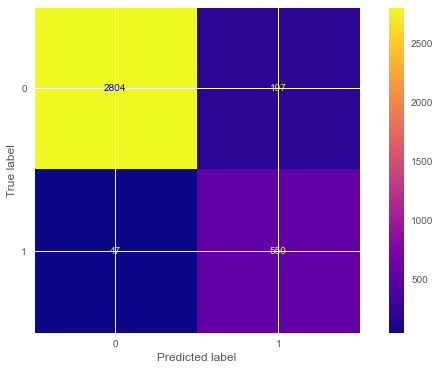

In [194]:
print("RF_tuned")
print ("------------------")
eval(RF_tuned, X_train, X_test)

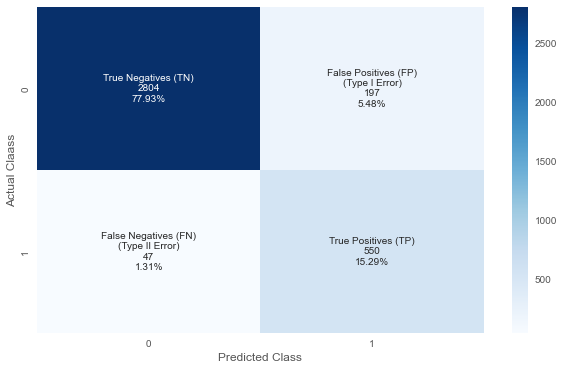

In [195]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

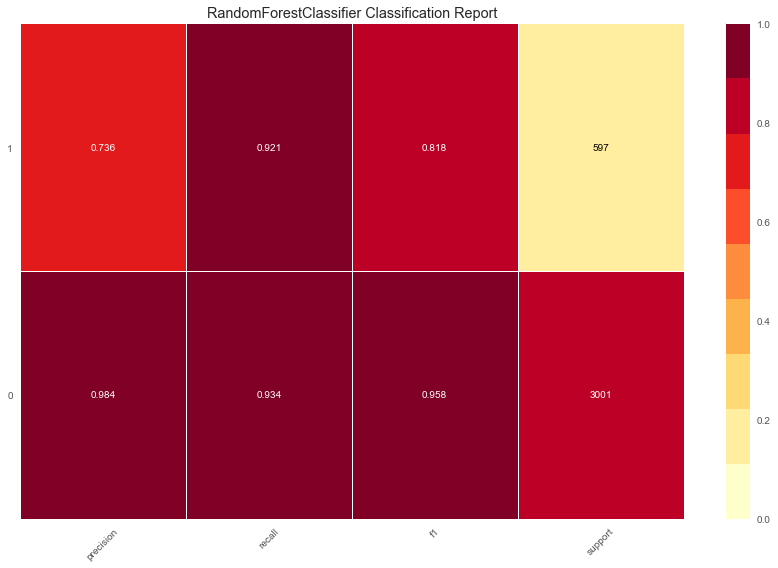

<AxesSubplot:title={'center':'RandomForestClassifier Classification Report'}>

In [196]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(RF_tuned, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [197]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.932,0.932
Precision,0.731,0.736
Recall,0.937,0.921
f1,0.821,0.818


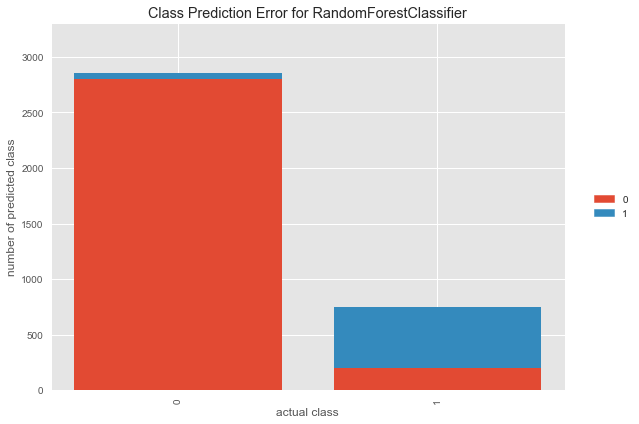

In [198]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(RF_tuned)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.5.6 Random Forest Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

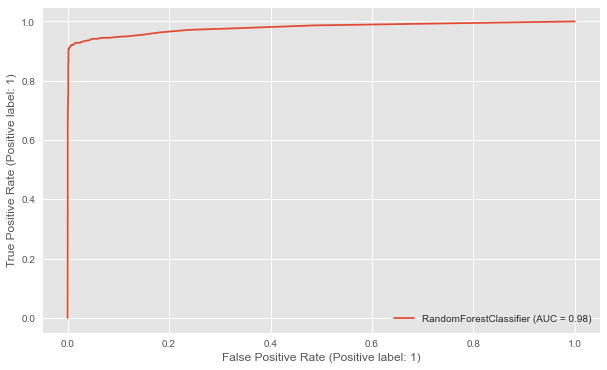

In [199]:
plot_roc_curve(RF_model, X_test, y_test);

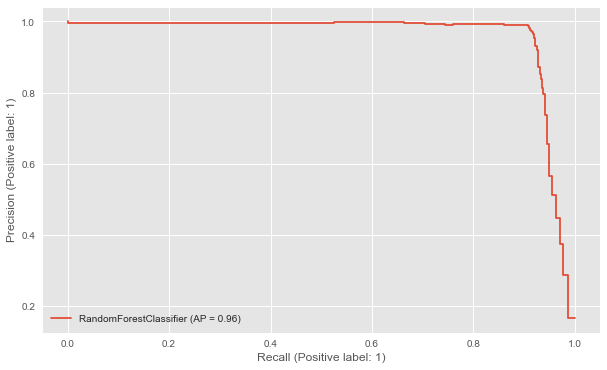

In [200]:
plot_precision_recall_curve(RF_model, X_test, y_test);

### 8.5.7 Prediction

In [201]:
RF_Pred = {"Actual": y_test, "RF_Pred":y_pred}
RF_Pred = pd.DataFrame.from_dict(RF_Pred)
RF_Pred.head(20)

,Actual,RF_Pred
3118,0,0
10490,0,0
1106,1,1
3822,0,0
6873,0,0
9581,0,0
9712,0,0
8794,0,0
4830,0,0
179,1,1


In [202]:
RF_Pred.drop("Actual", axis = 1, inplace = True)
Model_Preds = pd.merge(Model_Preds, RF_Pred, left_index = True, right_index = True)
Model_Preds.head(20)

,Actual,GB_Pred,KNN_Pred,RF_Pred
3118,0,0,0,0
10490,0,0,0,0
1106,1,1,1,1
3822,0,0,0,0
6873,0,0,0,0
9581,0,0,0,0
9712,0,0,0,0
8794,0,0,0,0
4830,0,0,0,0
179,1,1,1,1


In [203]:
Model_Preds.sample(10)

,Actual,GB_Pred,KNN_Pred,RF_Pred
2029,0,0,0,0
6289,0,0,0,0
5746,0,0,0,0
10188,0,0,0,0
5812,0,0,0,0
8442,0,0,0,0
5636,0,0,0,0
4393,0,0,0,0
884,1,1,1,1
1324,1,1,1,0


## 8.6 - CatBoost Classifier
### 8.6.1 Model Building

In [204]:
from catboost import CatBoostClassifier

CB_model = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)
CB_model.fit(X_train, y_train)
y_pred = CB_model.predict(X_test)
y_train_pred = CB_model.predict(X_train)

CB_model_f1 = f1_score(y_test, y_pred)
CB_model_acc = accuracy_score(y_test, y_pred)
CB_model_recall = recall_score(y_test, y_pred)
CB_model_auc = roc_auc_score(y_test, y_pred)

### 8.6.2 Evaluating Model Performance

CB_Model
------------------
[[2977   24]
 [  47  550]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      3001
           1       0.96      0.92      0.94       597

    accuracy                           0.98      3598
   macro avg       0.97      0.96      0.96      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       0.98      0.99      0.98      1394

    accuracy                           0.99      8393
   macro avg       0.99      0.99      0.99      8393
weighted avg       0.99      0.99      0.99      8393



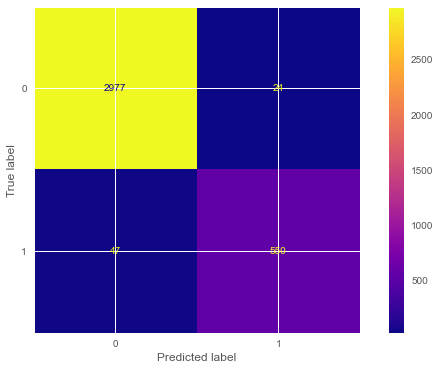

In [205]:
print("CB_Model")
print ("------------------")
eval(CB_model, X_train, X_test)

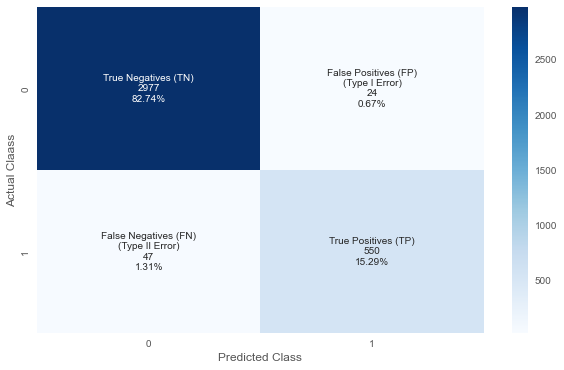

In [206]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

In [207]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.994,0.980
Precision,0.977,0.958
Recall,0.987,0.921
f1,0.982,0.939


### 8.6.3 Feature Importance for CatBoost Model

In [208]:
CB_feature_imp = pd.DataFrame(index = X.columns, data = CB_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
CB_feature_imp

,Importance
satisfaction_level,26.423
time_spend_company,20.504
number_project,15.951
average_montly_hours,14.938
last_evaluation,13.180
salary_low,1.730
work_accident,1.684
salary_medium,1.175
department_support,0.892
department_sales,0.886


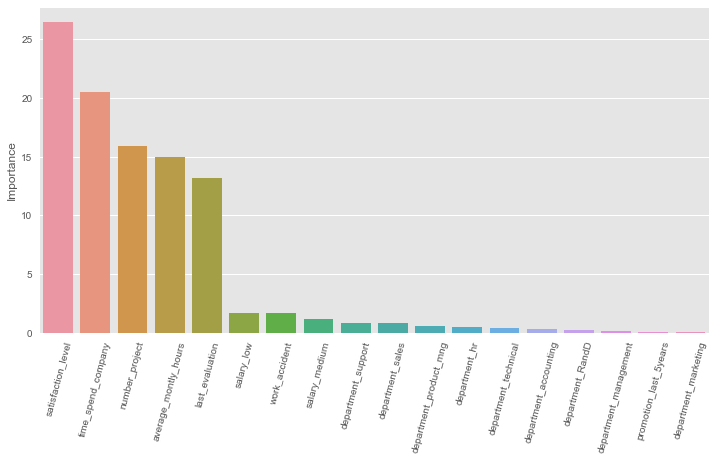

In [209]:
plt.figure(figsize = (12, 6))
sns.barplot(data = CB_feature_imp.sort_values('Importance', ascending = False), x = CB_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

### 8.6.4 CatBoost Classifier Cross Validation

In [210]:
CB_cv = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)

CB_cv_scores = cross_validate(CB_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
CB_cv_scores = pd.DataFrame(CB_cv_scores, index = range(1, 11))

CB_cv_scores.mean()[2:]

test_accuracy    0.980
test_precision   0.952
test_recall      0.924
test_f1          0.938
test_roc_auc     0.983
dtype: float64

In [211]:
CB_cm = confusion_matrix(y_test, y_pred)
CB_cm

array([[2977,   24],
       [  47,  550]], dtype=int64)

In [212]:
CB_cm_df = pd.DataFrame(CB_cm)
CB_cm_df

,0,1
0,2977,24
1,47,550


In [213]:
CB_cm_df = CB_cm_df.rename(columns={0:"Employee_Stayed", 1:"Employe_Left"}, index={0:"Employee_Stayed", 1:"Employe_Left"})
CB_cm_df

,Employee_Stayed,Employe_Left
Employee_Stayed,2977,24
Employe_Left,47,550


In [214]:
CB_cm_df["Total"] = CB_cm_df["Employee_Stayed"] + CB_cm_df["Employe_Left"]
CB_cm_df

,Employee_Stayed,Employe_Left,Total
Employee_Stayed,2977,24,3001
Employe_Left,47,550,597


In [215]:
fig = px.bar(CB_cm_df, x="Employee_Stayed", y="Total", color="Employe_Left", title="CatBoost Confusion Matrix Distribution")

fig.update_layout(
    xaxis_title="Employees-Left                      Employees_Stayed",
    yaxis_title="The Number of Employees",
    font=dict(
        family="Courier New, monospace",
        size=14,
        color="#7f7f7f"
    )
)

fig.show()

### 8.6.5 CatBoost Classifier GridSearchCV

In [216]:
param_grid = {'learning_rate': [0.01, 0.03, 0.1, 0.5],
              'depth': [4, 6, 8, 10],
              'l2_leaf_reg': [1, 3, 5, 7, 9]}

In [217]:
CB_grid = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)
CB_grid_model = GridSearchCV(estimator = CB_grid, 
                             param_grid = param_grid, 
                             scoring = "recall", 
                             n_jobs = -1, verbose = 0)
CB_grid_model.fit(X_train, y_train)

GridSearchCV(estimator=<catboost.core.CatBoostClassifier object at 0x000001970709EAF0>,
             n_jobs=-1,
             param_grid={'depth': [4, 6, 8, 10], 'l2_leaf_reg': [1, 3, 5, 7, 9],
                         'learning_rate': [0.01, 0.03, 0.1, 0.5]},
             scoring='recall')

In [218]:
CB_grid_model.best_params_

{'depth': 4, 'l2_leaf_reg': 3, 'learning_rate': 0.01}

In [219]:
print(colored('\033[1mBest Parameters of GridSearchCV for Random Forest Model:\033[0m', 'blue'), 
      colored(CB_grid_model.best_params_, 'cyan'))

Best Parameters of GridSearchCV for Random Forest Model: {'depth': 4, 'l2_leaf_reg': 3, 'learning_rate': 0.01}


In [220]:
CB_tuned = CatBoostClassifier(verbose = False, 
                              scale_pos_weight = 4,
                              depth = 4,
                              l2_leaf_reg = 3,
                              learning_rate = 0.01,
                              random_state = 101).fit(X_train, y_train)  

In [221]:
y_pred = CB_tuned.predict(X_test)
y_train_pred = CB_tuned.predict(X_train)

CB_tuned_f1 = f1_score(y_test, y_pred)
CB_tuned_acc = accuracy_score(y_test, y_pred)
CB_tuned_recall = recall_score(y_test, y_pred)
CB_tuned_auc = roc_auc_score(y_test, y_pred)

CB_tuned
------------------
[[2946   55]
 [  45  552]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      3001
           1       0.91      0.92      0.92       597

    accuracy                           0.97      3598
   macro avg       0.95      0.95      0.95      3598
weighted avg       0.97      0.97      0.97      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      6999
           1       0.92      0.94      0.93      1394

    accuracy                           0.98      8393
   macro avg       0.96      0.96      0.96      8393
weighted avg       0.98      0.98      0.98      8393



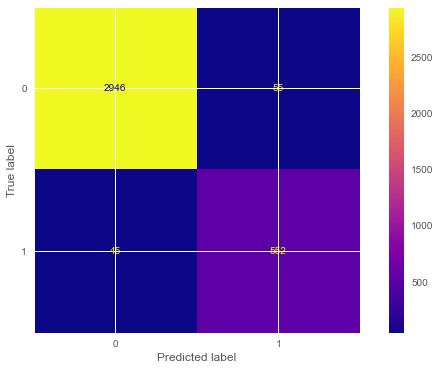

In [222]:
print("CB_tuned")
print ("------------------")
eval(CB_tuned, X_train, X_test)

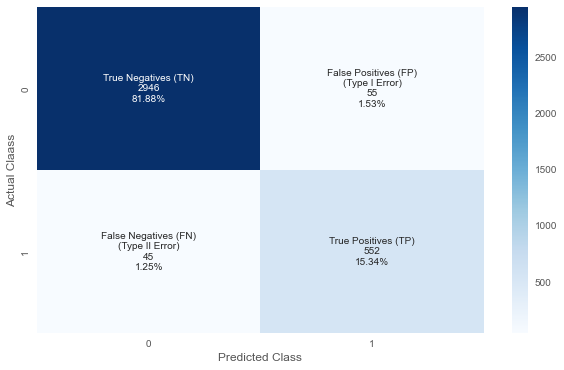

In [223]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

In [224]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.977,0.972
Precision,0.923,0.909
Recall,0.940,0.925
f1,0.931,0.917


In [225]:
CBtune_cm = confusion_matrix(y_test, y_pred)
CBtune_cm

array([[2946,   55],
       [  45,  552]], dtype=int64)

In [226]:
CBtune_cm_df = pd.DataFrame(CBtune_cm)
CBtune_cm_df

,0,1
0,2946,55
1,45,552


In [227]:
CBtune_cm_df = CBtune_cm_df.rename(columns={0:"Employee_Stayed", 1:"Employe_Left"}, index={0:"Employee_Stayed", 1:"Employe_Left"})
CBtune_cm_df

,Employee_Stayed,Employe_Left
Employee_Stayed,2946,55
Employe_Left,45,552


In [228]:
CBtune_cm_df["Total"] = CBtune_cm_df["Employee_Stayed"] + CBtune_cm_df["Employe_Left"]
CBtune_cm_df

,Employee_Stayed,Employe_Left,Total
Employee_Stayed,2946,55,3001
Employe_Left,45,552,597


In [229]:
fig = px.bar(CBtune_cm_df, x="Employee_Stayed", y="Total", color="Employe_Left", title="CatBoost-Tuned Confusion Matrix Distribution")

fig.update_layout(
    xaxis_title="Employees-Left                      Employees_Stayed",
    yaxis_title="The Number of Employees",
    font=dict(
        family="Courier New, monospace",
        size=14,
        color="#7f7f7f"
    )
)

fig.show()

### 8.6.6 CatBoost Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

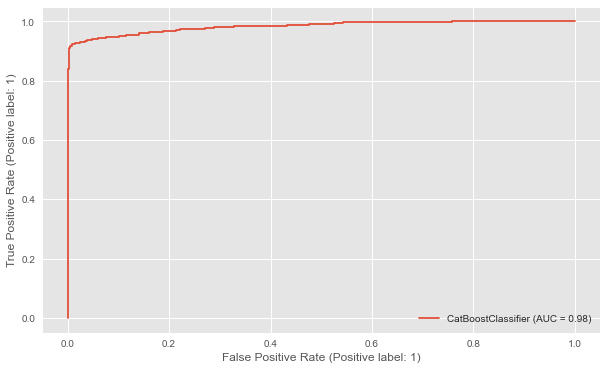

In [230]:
plot_roc_curve(CB_model, X_test, y_test);

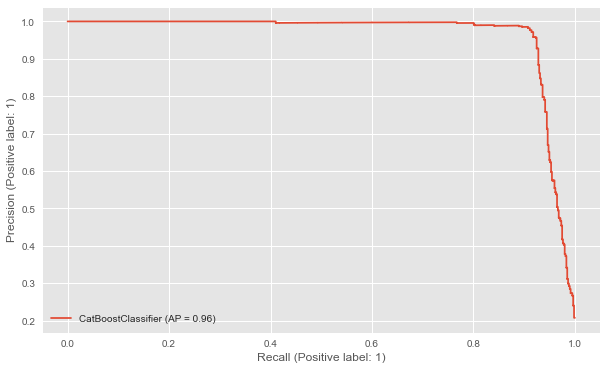

In [231]:
plot_precision_recall_curve(CB_model, X_test, y_test);

### 8.6.7 Prediction

In [232]:
CB_Pred = {"Actual": y_test, "CB_Pred":y_pred}
CB_Pred = pd.DataFrame.from_dict(CB_Pred)
CB_Pred.head()

,Actual,CB_Pred
3118,0,0
10490,0,0
1106,1,1
3822,0,0
6873,0,0


In [233]:
CB_Pred.drop("Actual", axis = 1, inplace = True)
Model_Preds = pd.merge(Model_Preds, CB_Pred, left_index = True, right_index = True)
Model_Preds.head()

,Actual,GB_Pred,KNN_Pred,RF_Pred,CB_Pred
3118,0,0,0,0,0
10490,0,0,0,0,0
1106,1,1,1,1,1
3822,0,0,0,0,0
6873,0,0,0,0,0


In [234]:
Model_Preds.sample(10)

,Actual,GB_Pred,KNN_Pred,RF_Pred,CB_Pred
11722,0,0,0,0,0
7846,0,0,0,0,0
10250,0,0,0,0,0
4278,0,0,0,0,0
8479,0,0,0,0,0
9491,0,0,0,0,0
1173,1,1,1,1,1
3411,0,0,0,0,0
8882,0,0,0,0,0
901,1,1,1,1,1


In [235]:
Model_Preds.loc[7347]

Actual      0
GB_Pred     0
KNN_Pred    0
RF_Pred     1
CB_Pred     0
Name: 7347, dtype: int64

In [236]:
df2.loc[7347]

satisfaction_level         0.300
last_evaluation            0.470
number_project             6.000
average_montly_hours     141.000
time_spend_company         6.000
work_accident              0.000
promotion_last_5years      0.000
left                       0.000
department_RandD           0.000
department_accounting      0.000
department_hr              0.000
department_management      0.000
department_marketing       0.000
department_product_mng     0.000
department_sales           1.000
department_support         0.000
department_technical       0.000
salary_low                 1.000
salary_medium              0.000
Name: 7347, dtype: float64

## 9) THE COMPARISON OF MODELS

In [237]:
compare = pd.DataFrame({"Model": ["GB_model", "GB_tuned", "KNN_Model", "KNN_tuned3", "RF_model", "RF_tuned", "CB_model", 
                                  "CB_tuned"],
                        
                        "F1_Score": [GB_model_f1, GB_tuned_f1, KNN_model_f1, KNN_tuned3_f1, RF_model_f1, RF_tuned_f1, 
                                     CB_model_f1, CB_tuned_f1],
                                                 
                        "Accuracy_Score": [GB_model_acc, GB_tuned_acc, KNN_model_acc, KNN_tuned3_acc, RF_model_acc, 
                                           RF_tuned_acc, CB_model_acc, CB_tuned_acc],
                        
                        "Recall_Score": [GB_model_recall, GB_tuned_recall, KNN_model_recall, KNN_tuned3_recall, RF_model_recall, 
                                     RF_tuned_recall, CB_model_recall, CB_tuned_recall],
                       
                        "ROC_AUC_Score": [GB_model_auc, GB_tuned_auc, KNN_model_auc, KNN_tuned3_auc, RF_model_auc, 
                                          RF_tuned_auc, CB_model_auc, CB_tuned_auc]})

compare = compare.sort_values(by="Recall_Score", ascending=True)
fig = px.bar(compare, x = "Recall_Score", y = "Model", title = "Recall_Score")
fig.show()

compare = compare.sort_values(by="F1_Score", ascending=True)
fig = px.bar(compare, x = "F1_Score", y = "Model", title = "F1_Score")
fig.show()

compare = compare.sort_values(by="Accuracy_Score", ascending=True)
fig = px.bar(compare, x = "Accuracy_Score", y = "Model", title = "Accuracy_Score")
fig.show()

compare = compare.sort_values(by="ROC_AUC_Score", ascending=True)
fig = px.bar(compare, x = "ROC_AUC_Score", y = "Model", title = "ROC_AUC_Score")
fig.show()

## 10) MODEL DEPLOYMENT
Save and Export the Model as .pkl\
Save and Export Variables as .pkl

### 10.1 - Save and Export the Model as .pkl

In [238]:
gradient_boosting_classifier = pickle.dump(GB_tuned, open('gradient_boosting_model', 'wb'))

<IPython.core.display.Javascript object>

In [239]:
kneighbors_classifier = pickle.dump(KNN_tuned3, open('kneighbors_model', 'wb'))

<IPython.core.display.Javascript object>

In [240]:
random_forest_classifier = pickle.dump(RF_tuned, open('random_forest_model', 'wb'))

<IPython.core.display.Javascript object>

In [241]:
catboost_classifier = pickle.dump(CB_tuned, open('catboost_model', 'wb'))

<IPython.core.display.Javascript object>

### 10.2 - Save and Export Variables as .pkl

In [242]:
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left,predicted_clusters
0,0.380,0.530,2,157,3,0,0,sales,low,1,2
1,0.800,0.860,5,262,6,0,0,sales,medium,1,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1,1
3,0.720,0.870,5,223,5,0,0,sales,low,1,2
4,0.370,0.520,2,159,3,0,0,sales,low,1,2


In [243]:
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0


In [244]:
df2.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,1,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,1,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,1,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0


In [245]:
df.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'department', 'salary', 'left',
       'predicted_clusters'],
      dtype='object')

In [246]:
df1.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'department_RandD', 'department_accounting',
       'department_hr', 'department_management', 'department_marketing',
       'department_product_mng', 'department_sales', 'department_support',
       'department_technical', 'salary_low', 'salary_medium'],
      dtype='object')

In [247]:
df2.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'left', 'department_RandD',
       'department_accounting', 'department_hr', 'department_management',
       'department_marketing', 'department_product_mng', 'department_sales',
       'department_support', 'department_technical', 'salary_low',
       'salary_medium'],
      dtype='object')

In [248]:
col_lst = ['satisfaction_level', 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 
           'work_accident', 'promotion_last_5years', 'department_RandD', 'department_accounting', 'department_hr', 
           'department_management', 'department_marketing', 'department_product_mng', 'department_sales', 
           'department_support', 'department_technical', 'salary_low', 'salary_medium']

scaler = MinMaxScaler()
scaler_fitted = scaler.fit(df2[col_lst])
scaler_deploy = pickle.dump(scaler_fitted, open('scaler.sav', 'wb'))

<IPython.core.display.Javascript object>

### What will be done to deploy our Model
1) Save you model using pickle (We did it in section 10.1).

2) Create a folder.

3) Inside the folder, create a .py extesion file which includes related codes for deployment and templates icluding index.htmml file if you will use flask for deployment(in our case we will use streamlit so we do NOT need it).

4) Put all related files including requirements.txt, all model files saved and images you will use in your .py file for deployment.

5) Sign in your account at https://aws.amazon.com/ and run your instance under ec2.

6) Open your Visual Studio Code IDE.

7) Make sure your Public IPv4 address at Open SSH configuratin file is the same as the one in your instance if you restart it again (If you change it do NOT forget to save).

8) Make a remote connection by connecting to Host via selecting related instance (Before doing this, if you wish, you can also publish the model at your local IP.).

9) After connecting the remote, put your folder by either "Open Folder" window or just drag and drop the folder. 10) Find and change your directory where your folder is by pwd, ls and cd commands.

11) Just run your .py file via streamlit run ".......".py (in our case streamlit run appN.py) (If there are NOT some libraries in your environment needed for deoployment or you need additional libraries for deployment please install them. Moreover, you have to need exact versions of libraries which you built your models with and needed for deployment).

12) Now you can see your deployment at External URL by clicking it.

13) However, you need a last step to be activated if you want it to be streamed even if you close your Visual Studio Code IDE.

14) Open and create a new tmux session via tmux and tmux new -s session_name, respectively (If you do NOT have Tmux package install it viaa sudo apt install tmux).

15) That's it! Now people enjoy your deployment and you can HAVE FUN...